# Quantify Improvements from L2HMC

## Imports

In [1]:
import os
import sys
import time
import pickle

#import numpy as np
import autograd.numpy as np
import numpy as onp
import pandas as pd
import tensorflow as tf
import seaborn as sns
import matplotlib.pyplot as plt


module_path = os.path.abspath(os.path.join('..'))
if module_path not in sys.path:
    sys.path.append(module_path)
    
%load_ext autoreload
%autoreload 2
np.set_printoptions(precision=3, linewidth=500, edgeitems=15, suppress=True)

import seaborn as sns
sns.set_palette('bright')

%config InlineBackend.figure_format = 'retina'

import matplotlib as mpl
import matplotlib.style as mplstyle

label_size = 9 
mpl.rcParams['xtick.labelsize'] = label_size 
mpl.rcParams['ytick.labelsize'] = label_size 

mplstyle.use('fast')

#from matplotlib import rc
#rc('text', usetex=False)

import utils.file_io as io

/Users/saforem2/opt/anaconda3/envs/tf2/lib/python3.6/site-packages/h5py/__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters


## Helper functions:

### Methods for finding and loading data from `run_dir`:

In [2]:
def get_losses(run_dir):
    """Returns plaq_loss, charge_loss from `run_dir`."""
    obs_dir = os.path.join(run_dir, 'observables')
    if os.path.isdir(obs_dir):
        run_dir = os.path.join(run_dir, obs_dir)
    plaq_loss = io.loadz(os.path.join(run_dir, 'plaq_loss.z'))
    charge_loss = io.loadz(os.path.join(run_dir, 'charge_loss.z'))
    return plaq_loss, charge_loss

def get_charges(run_dir):
    """Returns charges from `run_dir`."""
    obs_dir = os.path.join(run_dir, 'observables')
    if os.path.isdir(obs_dir):
        run_dir = os.path.join(run_dir, obs_dir)
        
    #fnew = os.path.join(run_dir, 'charges_new.z')
    #if os.path.isfile(fnew):
    #    return io.loadz(fnew)
    
    f = os.path.join(run_dir, 'charges.z')
    if os.path.isfile(f):
        return io.loadz(f)
    else:
        return None

def get_plaqs(run_dir):
    """Returns plaqs from `run_dir`."""
    obs_dir = os.path.join(run_dir, 'observables')
    if os.path.isdir(obs_dir):
        run_dir = os.path.join(run_dir, obs_dir)
    return io.loadz(os.path.join(run_dir, 'plaqs.z'))

## Helper methods for locating all `run_dir`'s containing inference data:

In [3]:
def get_run_dirs(log_dir, filter_str, use_tf_runs=False):
    """Returns all run_dirs found in `log_dir` containing `filter_str`.
    
    If `use_tf_runs`: 
    
        Look for `run_dirs` in `log_dir/runs_tf` instead of
        `log_dir/runs_np`.
    """
    if use_tf_runs:
        runs_dir = os.path.join(log_dir, 'runs_tf')
        if not os.path.isdir(runs_dir):
            print(f'Unable to locate `runs_tf`. Trying with `runs_np`...')
            runs_dir = os.path.join(log_dir, 'runs_np')
    else:
        runs_dir = os.path.join(log_dir, 'runs_np')
        if not os.path.isdir(runs_dir):
            print(f'Unable to locate `runs_np`. Trying with `runs_tf`...')
            runs_dir = os.path.join(log_dir, 'runs_tf')
        
    if not os.path.isdir(runs_dir):
        raise FileNotFoundError('Unable to locate any run_dir.')
        
    run_dirs = io.get_subdirs(runs_dir)
    run_dirs = [
        i for i in run_dirs if filter_str in i and 'mix_samplers' not in i
    ]
    
    return run_dirs

    
def plot_setup(log_dir, filter_str, use_tf_runs=False):
    """Setup for making plots.
    
    Explicitly, this function will find all run_dirs in `log_dir` containing
    `filter_str`. 
    
    If the `run_params` for a given `run_dir` do not exist, it will automatically
    extract the run_parameter values from the `run_dir` path.
    
    Returns:
        hdirs (list): List of HMC directories in `log_dir` containing `filter_str`.
        heps_arr (list): List of `eps` (step-size) values corresponding to each dir in `hdirs`.
        ldirs (list): List of L2HMC directories in `log_dir` containing `filter_str`.
        leps_arr (list): List of `eps` (step-size) values corresponding to each dir in `ldirs`.
        title_str: Nicely formatted string of parameters to be used in a plot title.
    """
    params = io.loadz(os.path.join(log_dir, 'params.z'))
    try:
        run_dirs = get_run_dirs(log_dir, filter_str, use_tf_runs=use_tf_runs)
    except FileNotFoundError:
        raise OSError('Unable to complete plot setup. Exiting.')
    
    hdirs = []
    ldirs = []
    #parr = []
    leps_arr = []
    heps_arr = []
    lbs_arr = []
    hbs_arr = []
    run_params = []
    for rd in run_dirs:
        run_str = rd.split('/')[-1]
        s = run_str.split('_')

        eps_str = s[4].lstrip('eps0')
        eps = float(f'0.{eps_str}')
        
        beta_str = str([i for i in s if 'beta' in i][0]).lstrip('beta')
        beta = float(f'{beta_str[0]}.{beta_str[1]}')
        #beta_str = s[3].lstrip('beta')
        #if beta_str.endswith('0'):
        #    beta = float(beta_str) / 10
        #else:
        #    beta = float(beta_str) / 100
        #    
        #beta_str = str(beta).replace('.', '')
        batch_size = int(s[1].lstrip('bs'))

        rp = {
            'num_steps': int(s[0].lstrip('lf')),
            'batch_size': int(s[1].lstrip('bs')),
            'run_steps': int(s[2].lstrip('steps')),
            'beta': beta,
            'eps':  float(f'0.{s[4].lstrip("eps0")}'),
            'nw': [float(i) for i in s[5].lstrip('nw')],
            'init': s[6].lstrip('init'),
        }
        run_params.append(rp)
        if 'nw000000' in rd:
            hdirs.append(rd)
            heps_arr.append(eps)
            hbs_arr.append(batch_size)
        if 'nw111111' in rd:
            ldirs.append(rd)
            leps_arr.append(eps)
            lbs_arr.append(batch_size)

    #batch_size = run_params[0]['batch_size']
    
    title_str = (f"{params['time_size']}"
                 r"$\times$" + f"{params['space_size']}, "
                 r"$\beta = $" + f'{beta:.3g}, '
                 r"$N_{\mathrm{LF}} = $" + f"{params['num_steps']}, "
                 r"$N_{\mathrm{B}} = $" + f'{batch_size}')
    
    if len(np.unique(leps_arr)) + len(np.unique(heps_arr)) == 2:
        title_str += ', ' + r"$\varepsilon = $" + f'{eps:.3g}'
    
    return hdirs, heps_arr, hbs_arr, ldirs, leps_arr, lbs_arr, title_str

## Calculate the tunneling rate, $\gamma$:

Explicitly, the **tunneling rate, $\gamma$,** is defined to be the average rate of change of the topological charge, $\mathcal{Q} \in \mathbb{Z}$ between subsequent states in the chain.

For an individual MCMC chain of length $M$, we compute the *tunneling rate* as:

\begin{equation}
\gamma = \frac{1}{M}\sum_{i} \delta\mathcal{Q}^{(i)} = \frac{1}{M} \sum_{i=1}^{M} \left|\mathcal{Q}^{(i)} - \mathcal{Q}^{(i-1)}\right|
\end{equation}

In [4]:
from plotters.data_utils import therm_arr

def get_dq(q):
    """Calculate the charge difference between steps."""
    q = np.insert(q, 0, q[0], axis=0)
    return np.abs(np.around(q[1:]) - np.around(q[:-1]))
    
def calc_tunneling_stats(charges):
    step_ax = 0  # data is appended for each step along axis 0
    num_steps = charges.shape[step_ax]
    # prepend a copy of the initial charge values to make sure
    # that q and dq have the same length (for plotting purposes)
    charges = np.insert(charges, 0, charges[0], axis=step_ax)
    # calculate:
    #  dq = [abs(q[1] - q[0]), ..., abs(q[n] - q[n-1])]
    dq = np.abs(np.around(charges[1:]) - np.around(charges[:-1]))
    # sum over all states in the chain
    tunneling_events = np.sum(dq, axis=step_ax)
    tunn_stats = {
        'tunneling_events': tunneling_events,
        'tunneling_rate': tunneling_events / num_steps,
    }
    return tunn_stats

## Plotting functions:

Methods for generating trace plots of the topological charge $\mathcal{Q}$ and density plots of the tunneling rate $\gamma$.

In [5]:
from plotters.plot_utils import get_title_str
from plotters.data_utils import therm_arr
from collections import namedtuple

Losses = namedtuple('Losses', ['steps', 'plaq', 'charge'])

label_size = 6 
mpl.rcParams['xtick.labelsize'] = label_size 
mpl.rcParams['ytick.labelsize'] = label_size 

c0 = 'C7'
c1 = 'C6'

def plot_pair_losses(log_dir, filter_str, copy_dst=None):
    hmc_dir, hmc_eps_arr, l2hmc_dir, l2hmc_eps_arr, title_str = plot_setup(log_dir, filter_str)
    hmc_dir = hmc_dir[0]
    l2hmc_dir = l2hmc_dir[0]
    plaq_loss_hmc, charge_loss_hmc = get_losses(hmc_dir)
    plaq_loss_l2hmc, charge_loss_l2hmc = get_losses(l2hmc_dir)
    
    charge_hmc, _ = therm_arr(charge_loss_hmc, therm_frac=0.33)
    plaq_hmc, steps_hmc = therm_arr(plaq_loss_hmc, therm_frac=0.33)

    charge_l2hmc, _ = therm_arr(charge_loss_l2hmc, therm_frac=0.33)
    plaq_l2hmc, steps_l2hmc = therm_arr(plaq_loss_l2hmc, therm_frac=0.33)

    fig, axes = plt.subplots(ncols=2, nrows=2)
    kwargs = {
        'markersize': 0.8,
        'ls': '',
        #'markeredgewidth': 0.6,
    }
    for idx in range(plaq_hmc.shape[1]):
        hmc_label = None
        l2hmc_label = None

        axes[0, 1].plot(steps_hmc, plaq_hmc[:, idx], marker='.', color=c0, label=hmc_label, **kwargs)
        axes[0, 1].plot(steps_l2hmc, plaq_l2hmc[:, idx], marker='.', alpha=0.7, color=c1, label=l2hmc_label, **kwargs)

        axes[1, 1].plot(steps_hmc, charge_hmc[:, idx], marker='.', color=c0, label=hmc_label, **kwargs)
        axes[1, 1].plot(steps_l2hmc, charge_l2hmc[:, idx], marker='.', alpha=0.7, color=c1, label=l2hmc_label, **kwargs)
        
    sns.kdeplot(plaq_hmc.flatten(), shade=True, ax=axes[0, 0], color=c0)
    sns.kdeplot(plaq_l2hmc.flatten(), shade=True, ax=axes[0, 0], color=c1)
    sns.kdeplot(charge_hmc.flatten(), shade=True, ax=axes[1, 0], color=c0, label='HMC', clip=(-5., 2.))
    sns.kdeplot(charge_l2hmc.flatten(), shade=True, ax=axes[1, 0], color=c1, label='L2HMC', clip=(-5., 2.))
    
    axes[0, 0].set_xlabel('plaq. loss', fontsize='large')
    axes[1, 0].set_xlabel('charge loss', fontsize='large')
    axes[0, 1].set_xlabel(f'step', fontsize='large')
    axes[1, 1].set_xlabel(f'step', fontsize='large')
    
    fig.suptitle(title_str, fontsize='x-large', y=1.05)
    plt.tight_layout()
    
    out_file = os.path.join(log_dir, 'figures_np', f'{filter_str}_losses.png')
    plt.savefig(out_file, dpi=400, bbox_inches='tight')
    if copy_dst is not None:
        _ = shutil.copy2(out_file, copy_dst)
    
    losses_hmc = Losses(steps_hmc, plaq_hmc, charge_hmc)
    losses_l2hmc = Losses(steps_l2hmc, plaq_l2hmc, charge_l2hmc)
    
    return losses_hmc, losses_l2hmc, title_str

In [6]:
import arviz as az
import xarray as xr

therm_frac= 0.33
plt.rcParams.update({'axes.titlesize': 10})

def update_data(data, therm_dict, charges,
                therm_frac=0.33, key='L2HMC', eps_arr=None):
    for idx, q in enumerate(charges):
        q = np.array(q)
        
        #q = q.T
        q, steps = therm_arr(q, therm_frac)
        
        key_ = f'{key}, eps: {eps_arr[idx]}, run: {idx}'
        if key_ in therm_dict:
            key_ += ' (1)'
            
        therm_dict[key_] = q
        
        #key_ = f'{key_}, run: {idx}'
        #if key_ in therm_dict or key_ in data:
        #    key_ += ' (1)'
            
        q = q.T
        chains = np.arange(q.shape[0])
        if key_ in data:
            key_ += ' '
            
        data[key_] = xr.DataArray(q, dims=['chain', 'draw'],
                                  coords=[chains, steps])
        #if include_dq:
        #    for n, x in enumerate(dq):
        #        x += ((n + 1) * (-1)**n)
        #if include_dq:
        #    data[dkey_] = xr.DataArray(dq, dims=['chain', 'draw'],
        #                               coords=[chains, steps])
            
    return data, therm_dict
    

#def get_hmc_charges(leapfrog_steps, beta)
    
def plot_charges(log_dir, filter_str, fft=0, include_dq=False, use_tf_runs=False):
    #hmc_dir, l2hmc_dir, title_str, eps_arr = plot_setup(log_dir, filter_str)
    try:
        hdirs, heps, hbs, ldirs, leps, lbs, title_str = plot_setup(log_dir, filter_str,
                                                                   use_tf_runs=use_tf_runs)
    except OSError as e:
        raise e
        
    qhmc = [get_charges(hd) for hd in hdirs]
    ql2hmc = [get_charges(ld) for ld in ldirs]
    
    data = {}
    therm_dict = {}
    
    qhmc = [q for q in qhmc if q is not None]
    for idx, q in enumerate(qhmc):
        q = np.array(q)
        q, steps = therm_arr(q, therm_frac=0.33)
        key_ = f'HMC, eps: {heps[idx]}'
        if key_ in therm_dict or key_ in data:
            key_ += f', run: {idx}'
            
        therm_dict[key_] = q
        q = q.T
        chains = np.arange(q.shape[0])
        if len(chains) > 100:
            q = q[:10, :]
            chains = np.arange(q.shape[0])
        data[key_] = xr.DataArray(np.around(q), dims=['chain', 'draw'],
                                  coords=[chains, steps])
        
    ql2hmc = [q for q in ql2hmc if q is not None]
    for idx, q in enumerate(ql2hmc):
        q = np.array(q)
        q, steps = therm_arr(q, therm_frac=0.33)
        key_ = f'L2HMC, eps: {leps[idx]}'
        if key_ in therm_dict or key_ in data:
            key_ += f', run: {idx}'
            
        therm_dict[key_] = q
        q = q.T
        chains = np.arange(q.shape[0])
        if len(chains) > 100:
            q = q[:10, :]
            chains = np.arange(q.shape[0])
        data[key_] = xr.DataArray(np.around(q), dims=['chain', 'draw'],
                                  coords=[chains, steps])
        
    tunn_rates = {}
    #fig, axes = plt.subplots(ncols=2, nrows=len(list(therm_dict.keys())))
    fig, ax = plt.subplots()
    for idx, (key, q) in enumerate(therm_dict.items()):
        dq = get_dq(q)
        tunn_rate = np.sum(dq, axis=0) / dq.shape[0]
        sns.kdeplot(tunn_rate.flatten(), shade=True, ax=ax, label=key)
        #for chain in q.T:
        #    axes[idx, 1].plot()
        
    fig.suptitle(title_str, fontsize=20)
    ax.set_xlabel('tunneling rate, ' + r"$\gamma$", fontsize='large')
    
    figs_str = 'tf' if use_tf_runs else 'np'
    figs_dir = os.path.join(log_dir, f'figures_{figs_str}')
    io.check_else_make_dir(figs_dir)
    
    out_file = os.path.join(figs_dir, f'{filter_str}_tunn_rates.png')
    #fstr = f'Saving figure to: {out_file}.'
    #ul = '-' * len(fstr)
    #print('\n'.join([fstr, ul]))
    plt.savefig(out_file, dpi=400, bbox_inches='tight')
    plt.show()
    
    #data = {}
    #therm_dict = {}
    #data, therm_dict = update_data(data, therm_dict, ql2hmc,
    #                               key='L2HMC', eps_arr=leps)
    #                               #include_dq=include_dq)
    #data, therm_dict = update_data(data, therm_dict, qhmc,
    #                               key='HMC', eps_arr=heps)
    #                               #include_dq=include_dq)
    #fig, ax = plt.subplots(nrows=len(list(data.keys())))
    #for key, val in data.items():
    #    ax.plot(np.array(steps, val)
                           
    
    #for key, val in data.items():
        
    
    dataset = xr.Dataset(data)
    az.plot_trace(dataset)#, trace_kwargs={'linewidth': 1.})
    fig = plt.gcf()
    fig.suptitle(title_str, fontsize=20, y=1.05)
    
    out_file = os.path.join(figs_dir, f'{filter_str}_charges.png')
    #out_file = os.path.join(log_dir, 'figures_np', f'{filter_str}_charges.png')
    #fstr = f'Saving figure to: {out_file}.'
    #ul = '-' * len(fstr)
    #print('\n'.join([fstr, ul]))
    #print(f'Saving figure to: {out_file}.')
    plt.savefig(out_file, dpi=400, bbox_inches='tight')
    plt.show()
    # --------------------------------------------------------
    

## Make plots:

 1. Find all unique values of $\beta$ for which we have inference data.
 2. For each value of $\beta$:   
     - Find all L2HMC inference runs carried out at this $\beta$.
     
     - Separate the L2HMC inference runs from the HMC inference runs:
     
 2. Find all inference runs that were carried out at each value of $\beta$.
 2. For each value of $\beta$, load in the topological charge data for each inference run carried out at thi

In [7]:
def get_unique_betas(log_dir):
    def _get_beta(rd):
        rs = rd.split('/')[-1].split('_')
        return rs[3]
    
    runs_dir = os.path.join(log_dir, 'runs_np')
    if os.path.isdir(runs_dir):
        run_dirs = [
            os.path.join(log_dir, 'runs_np', i)
            for i in os.listdir(os.path.join(log_dir, 'runs_np'))
        ]
        run_dirs = [rd for rd in run_dirs if os.path.isdir(rd)]
        betas = [_get_beta(rd) for rd in run_dirs]
    else:
        betas = []
        
    return np.unique(betas)

********************************************************************************
log_dir: /Users/saforem2/l2hmc-qcd/gauge_logs/gce_logs/2020_05_14/L16_b1024_lf2_GaugeNetwork_aw00_qw01_pw01_dp05_f32_0203
--------------------------------------------------------------------------------
filter_str: beta50


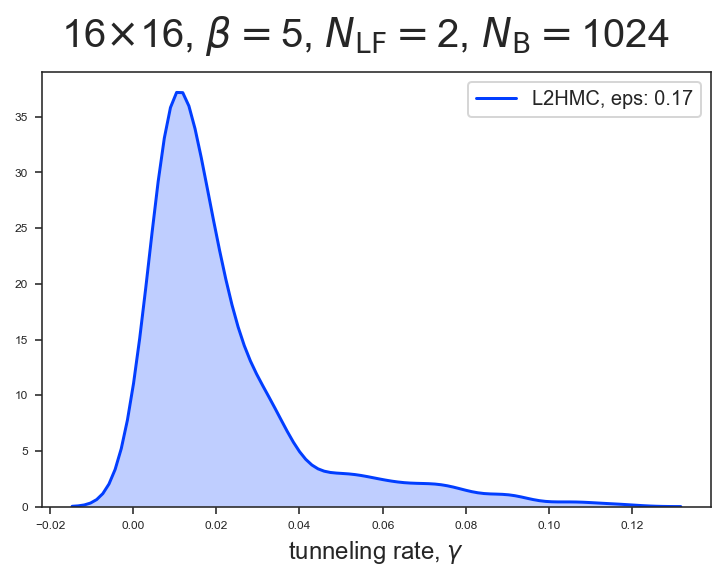

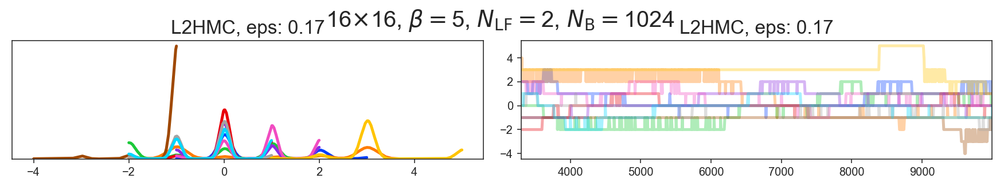

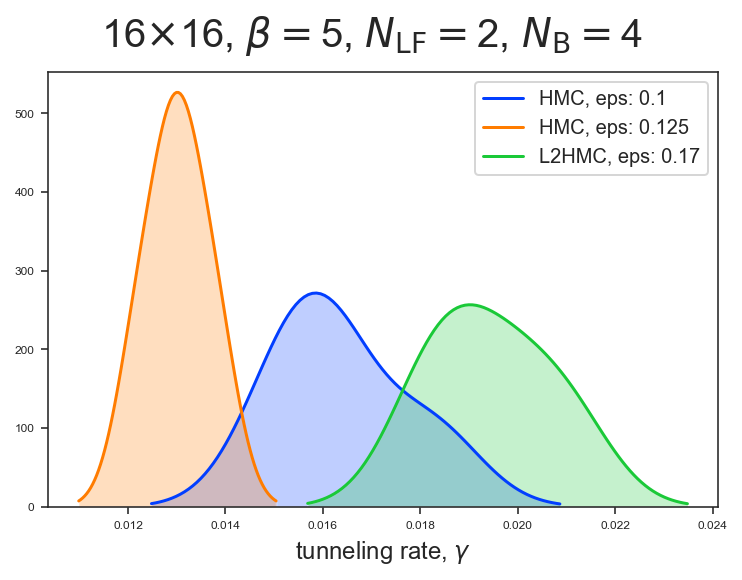

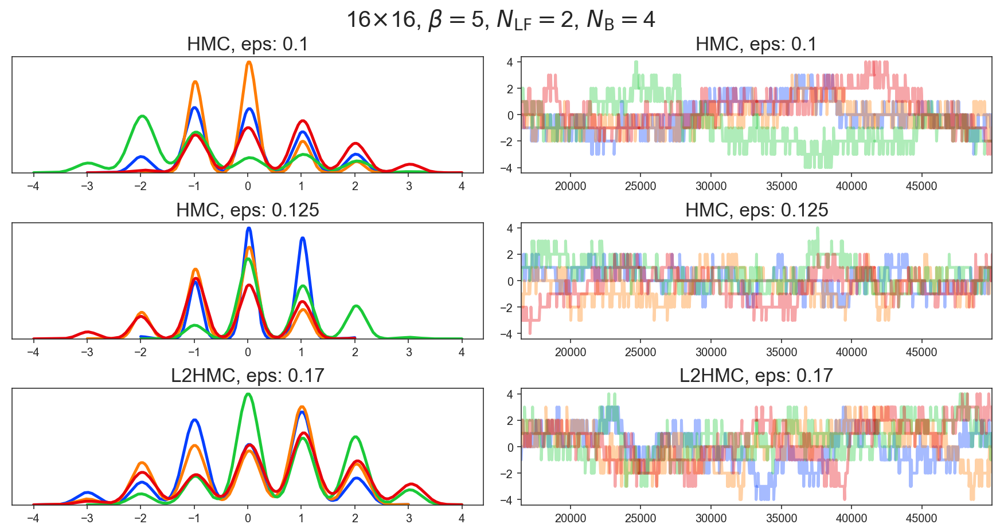

--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
filter_str: beta55


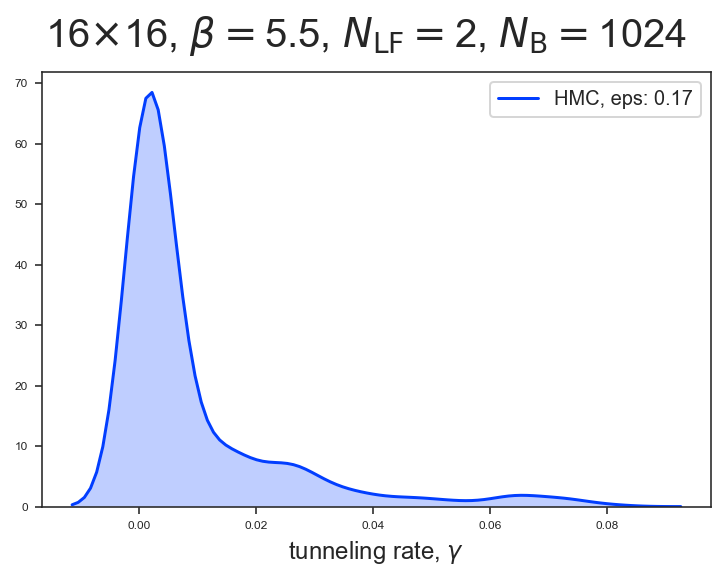

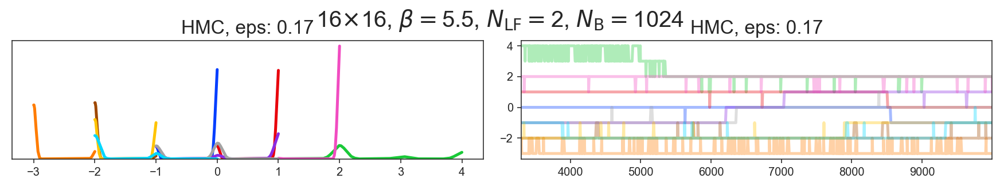

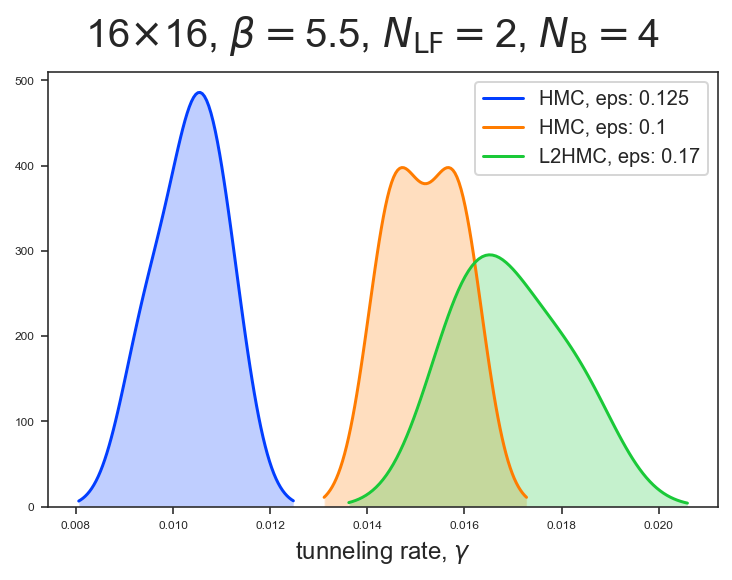

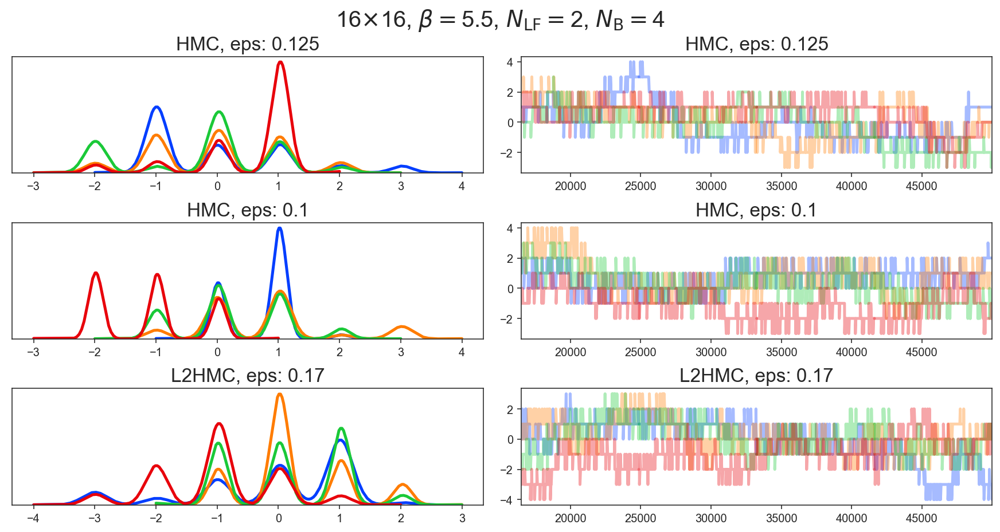

--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
filter_str: beta60


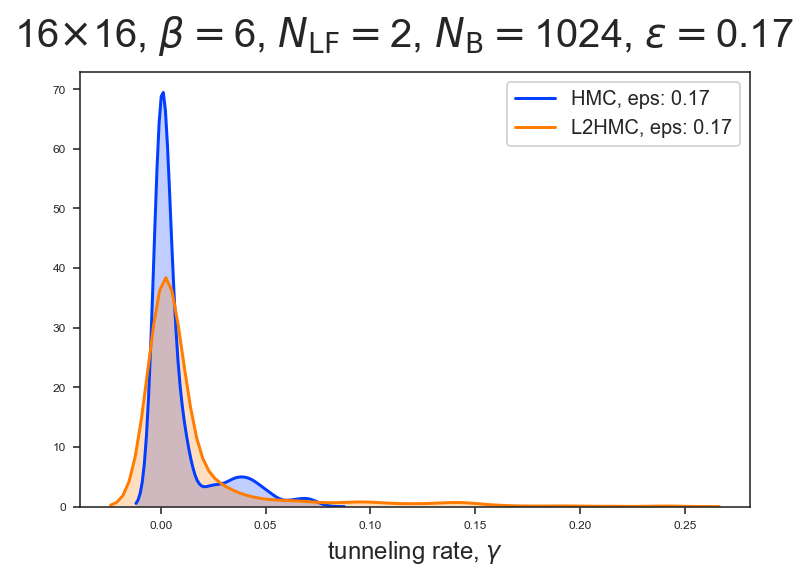

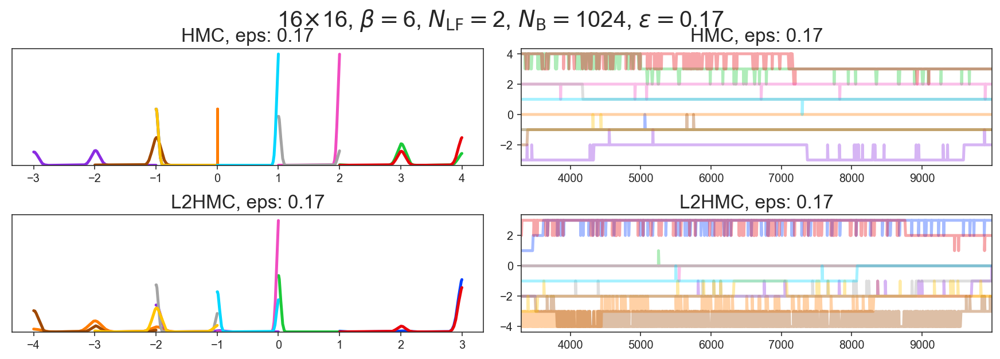

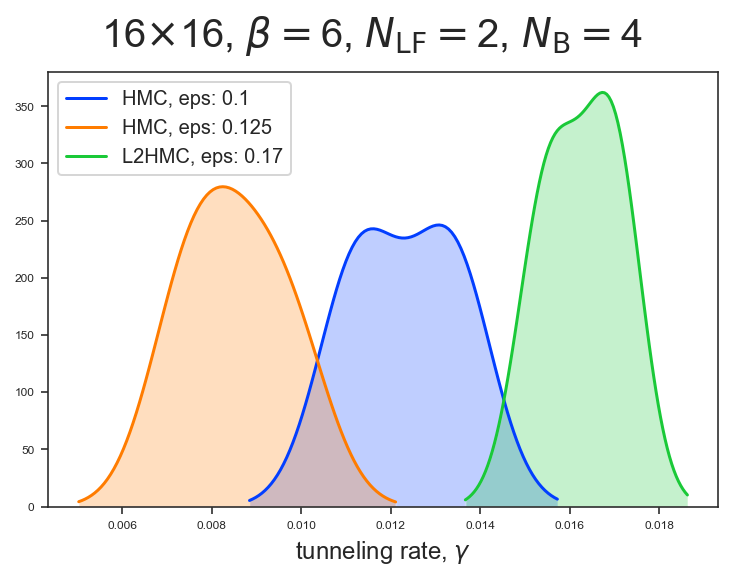

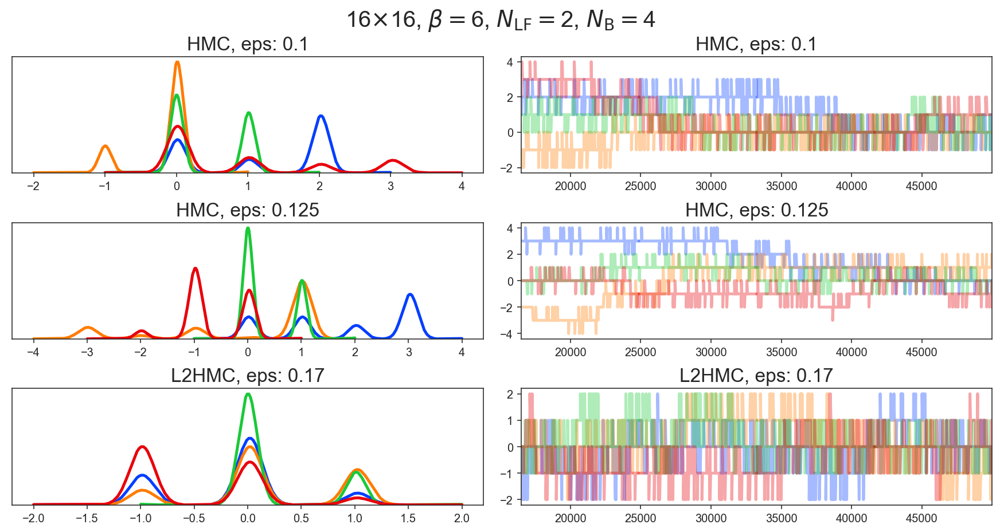

--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
filter_str: beta65


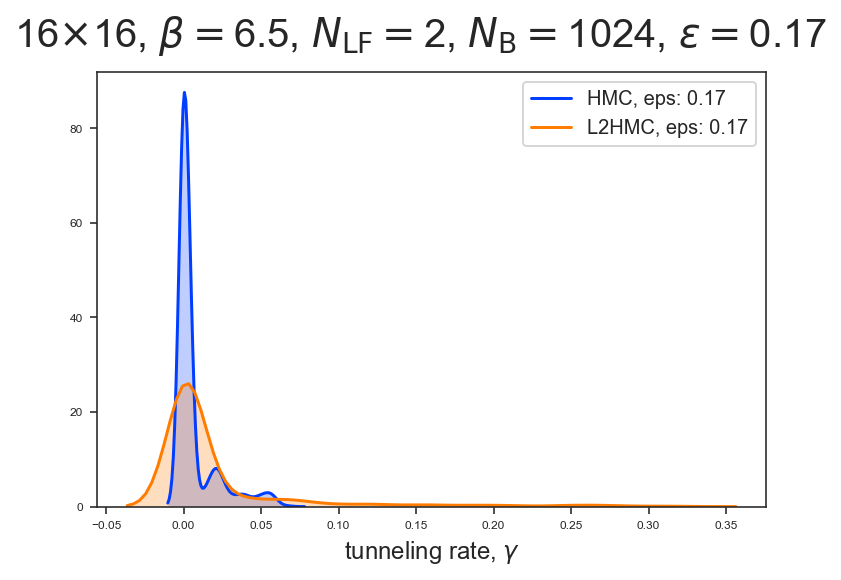

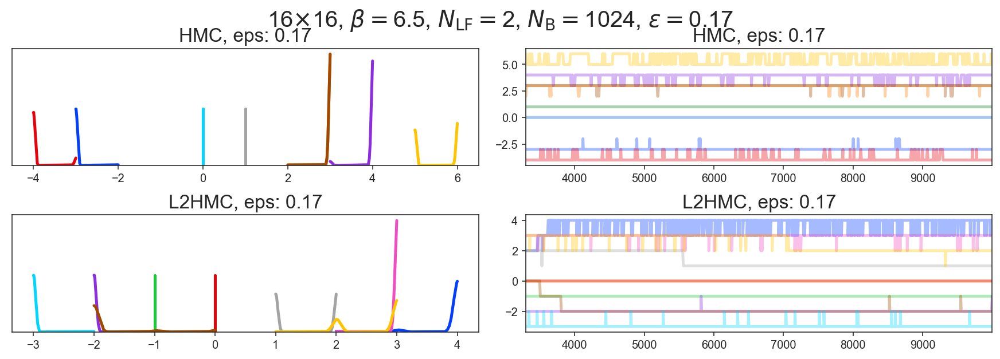

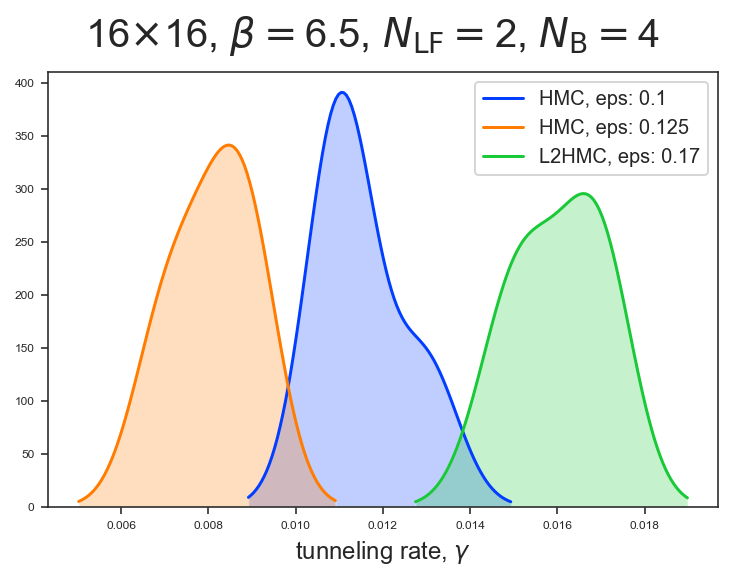

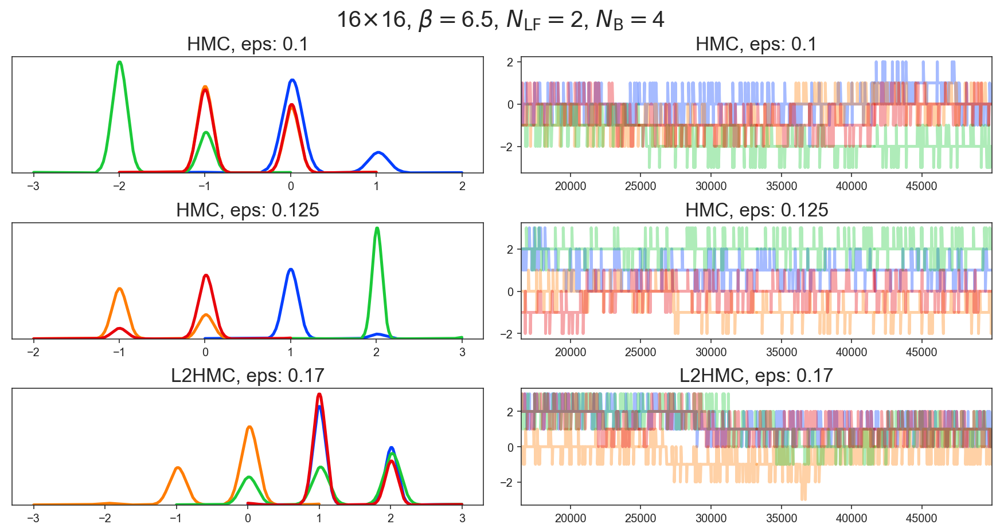

--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
filter_str: beta70


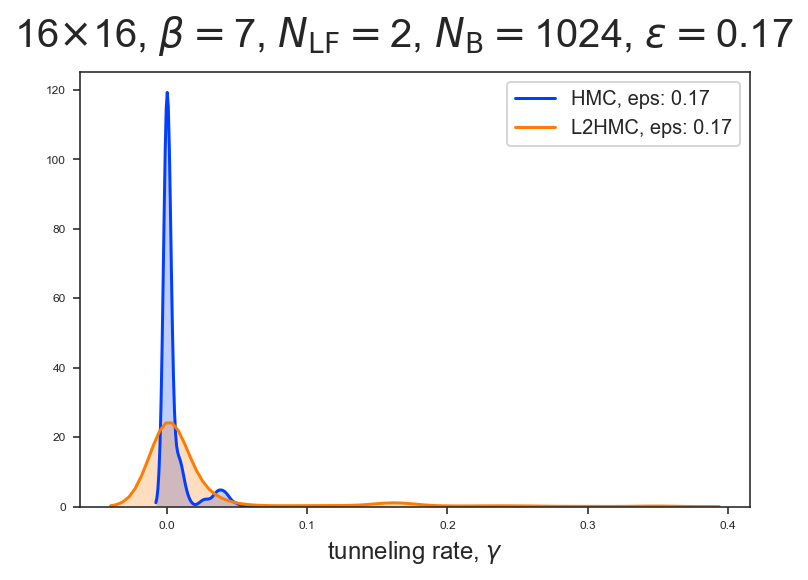

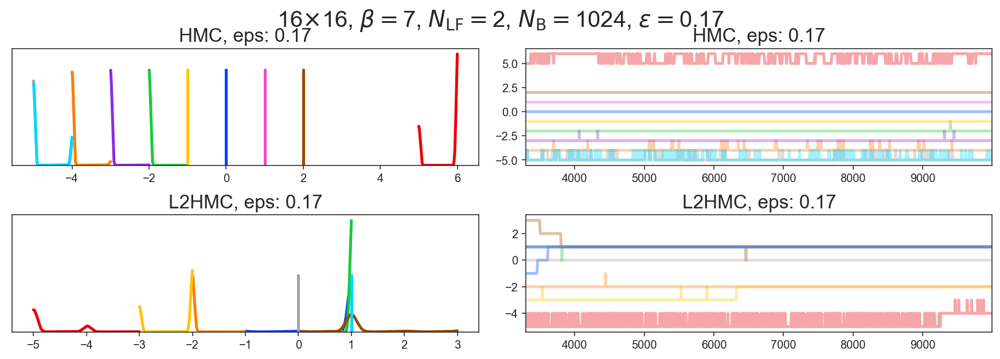

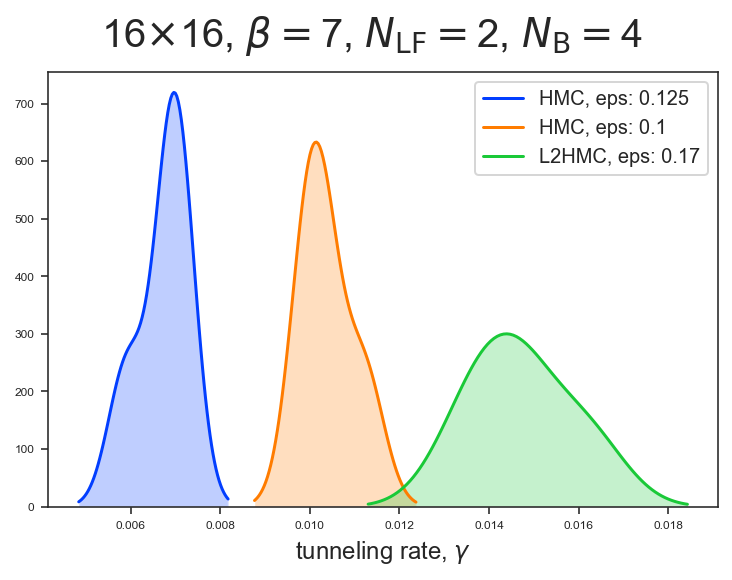

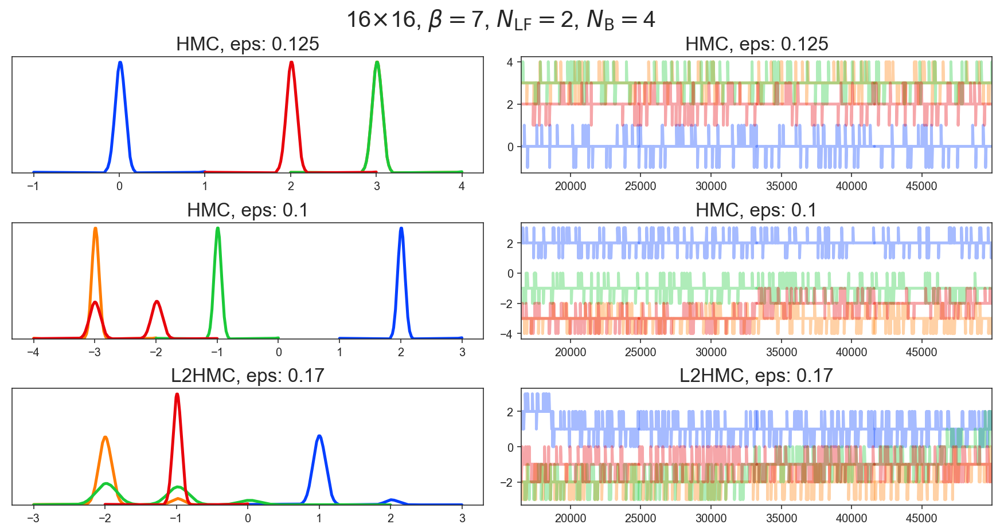

--------------------------------------------------------------------------------
********************************************************************************


********************************************************************************
log_dir: /Users/saforem2/l2hmc-qcd/gauge_logs/gce_logs/2020_05_14/L16_b1024_lf2_GaugeNetwork_aw00_qw01_pw01_dp05_f32_0203_1
--------------------------------------------------------------------------------
filter_str: beta50
Unable to locate `runs_tf`. Trying with `runs_np`...


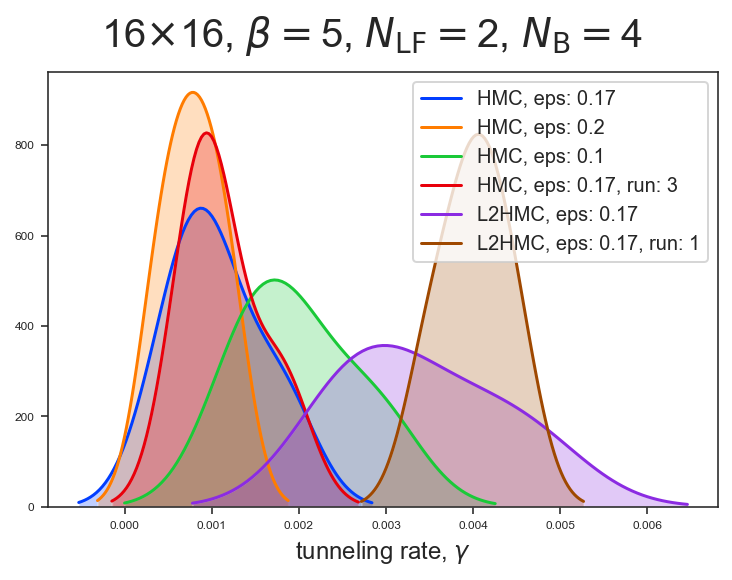

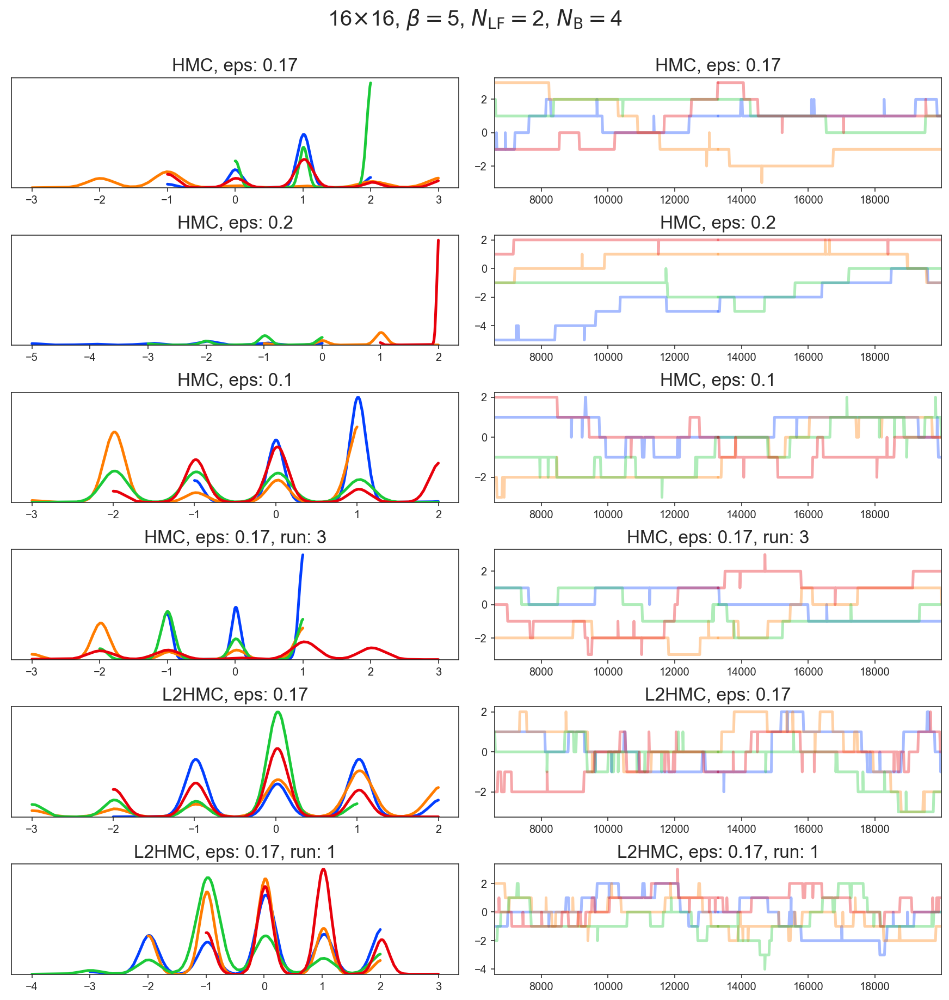

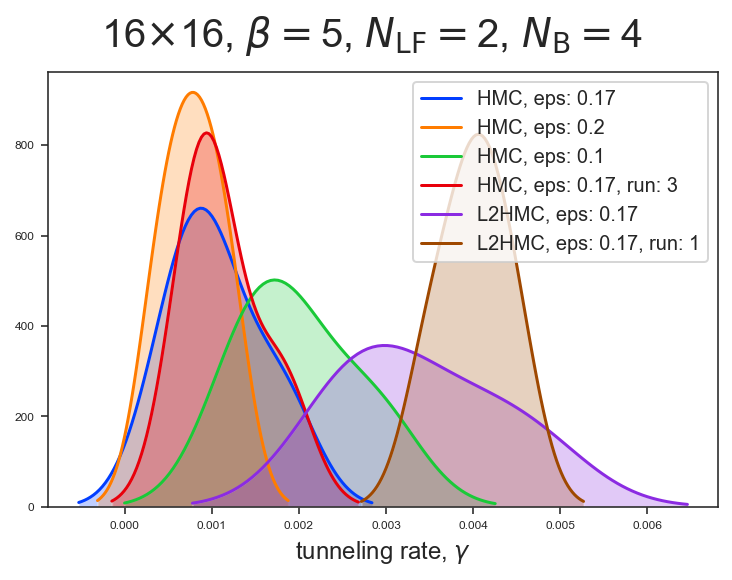

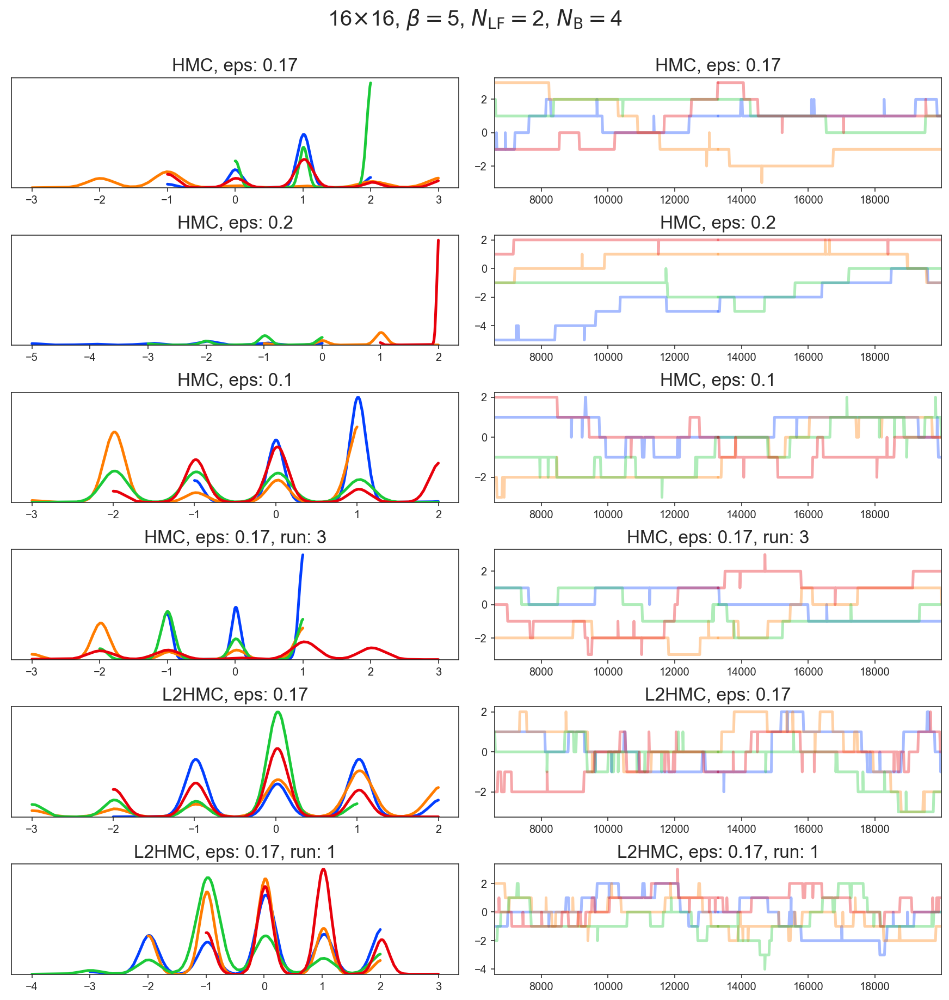

--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
filter_str: beta55
Unable to locate `runs_tf`. Trying with `runs_np`...


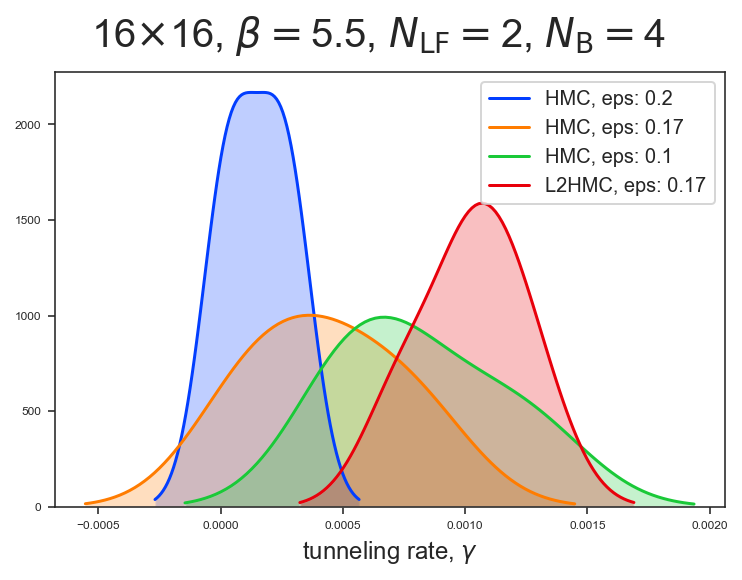

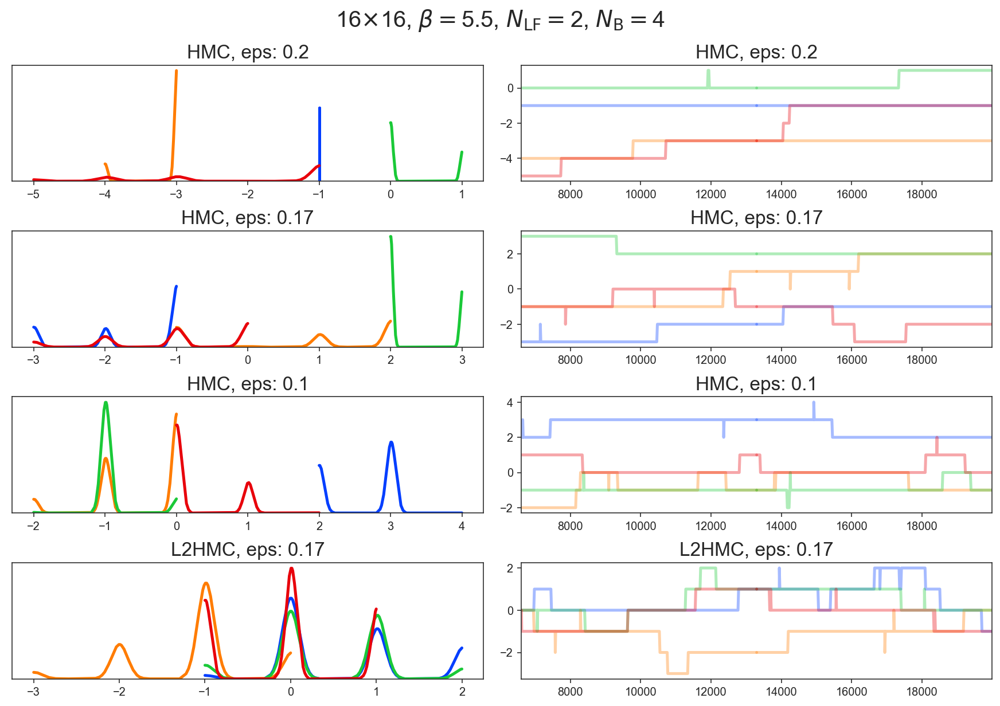

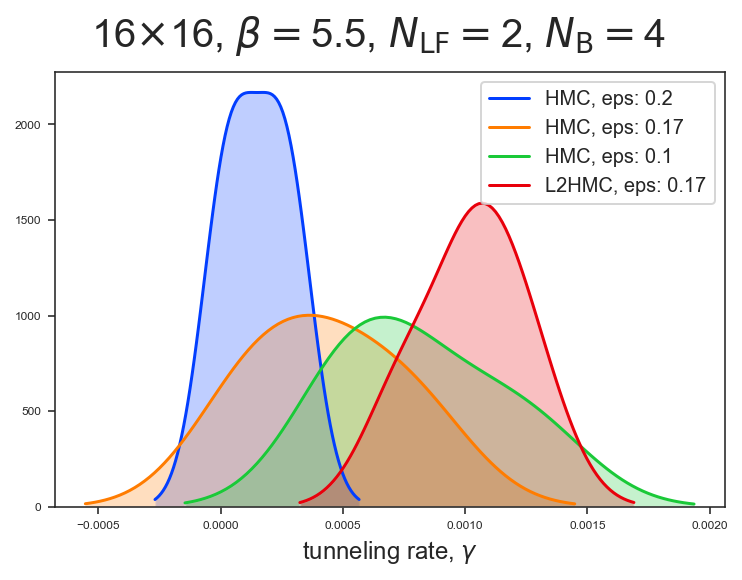

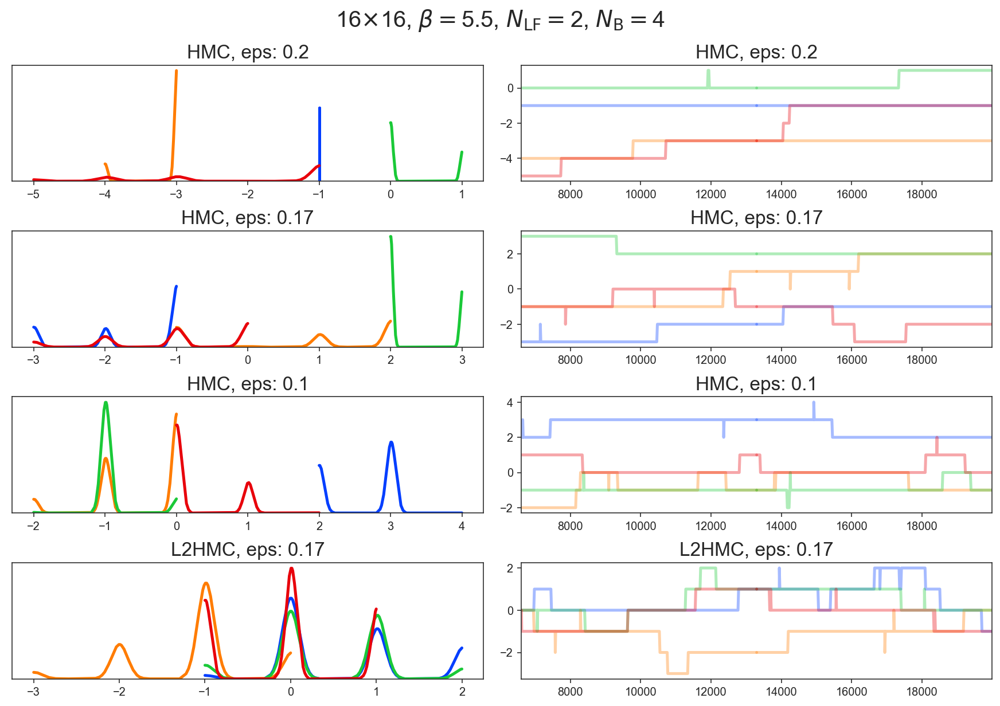

--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
filter_str: beta60
Unable to locate `runs_tf`. Trying with `runs_np`...


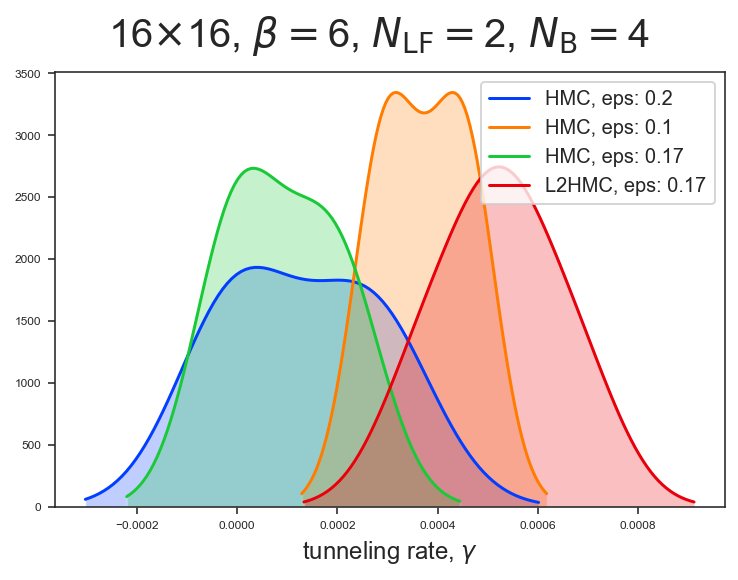

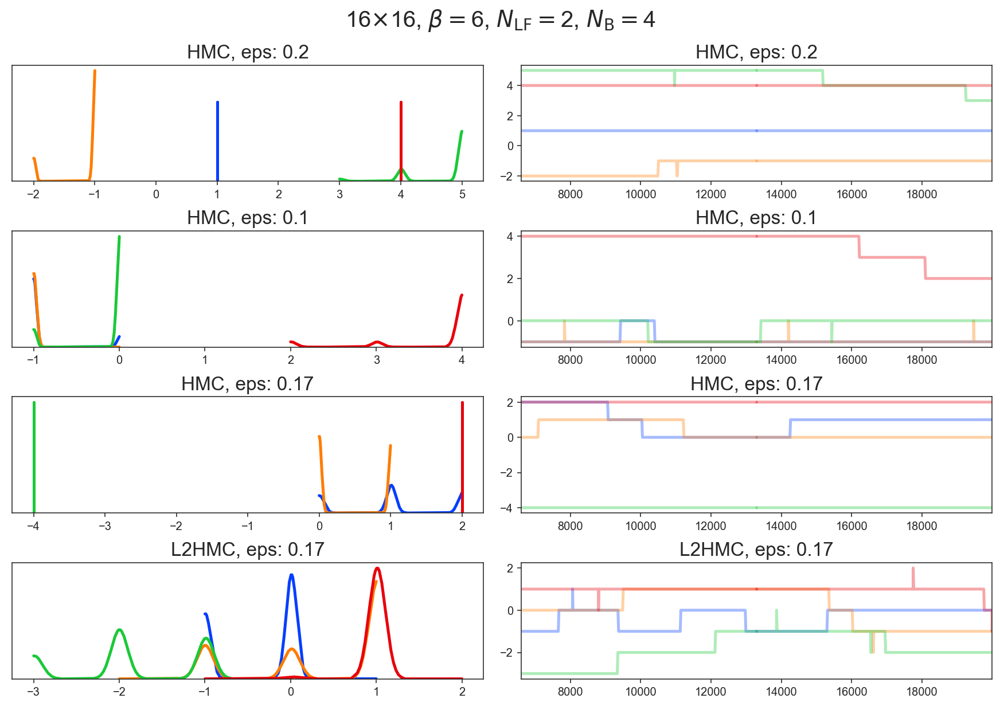

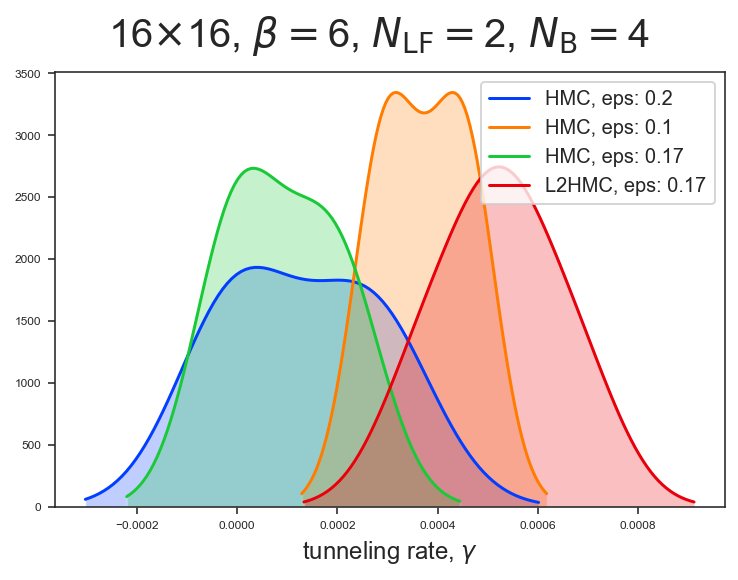

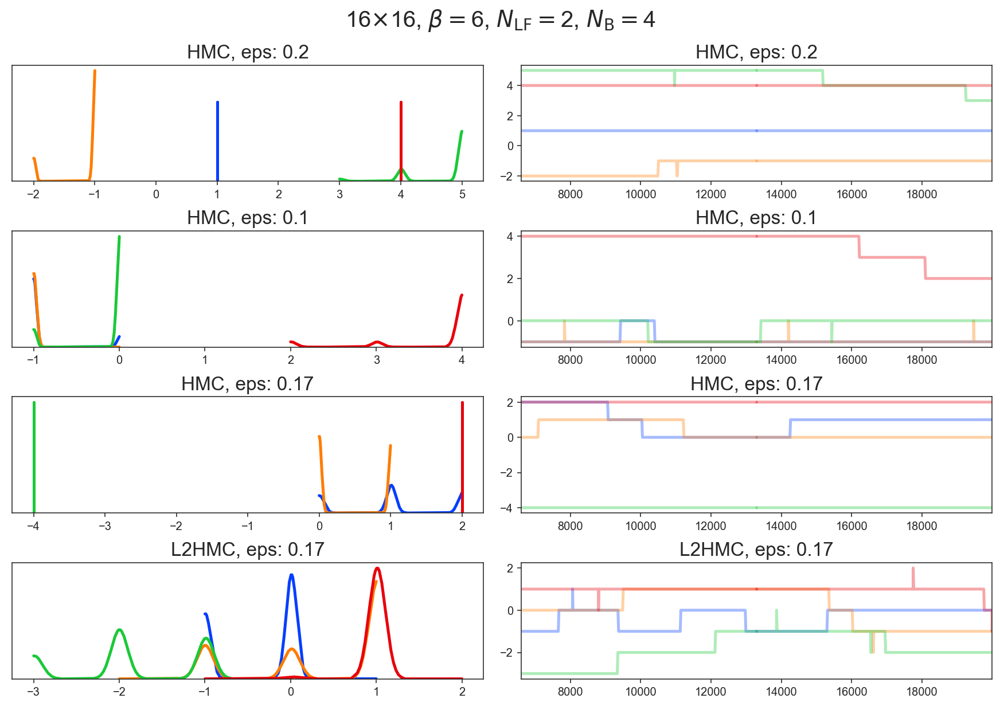

--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
filter_str: beta65
Unable to locate `runs_tf`. Trying with `runs_np`...


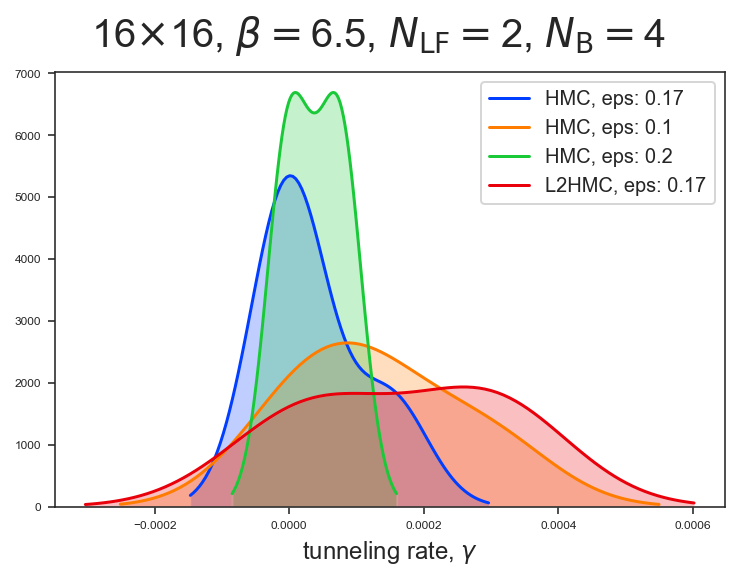

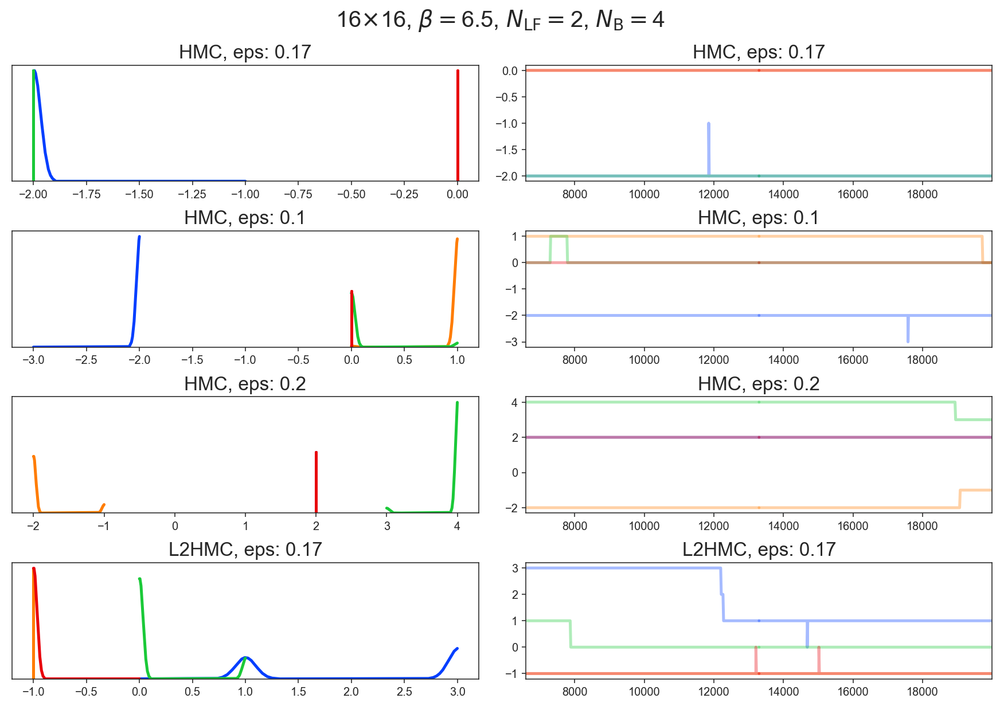

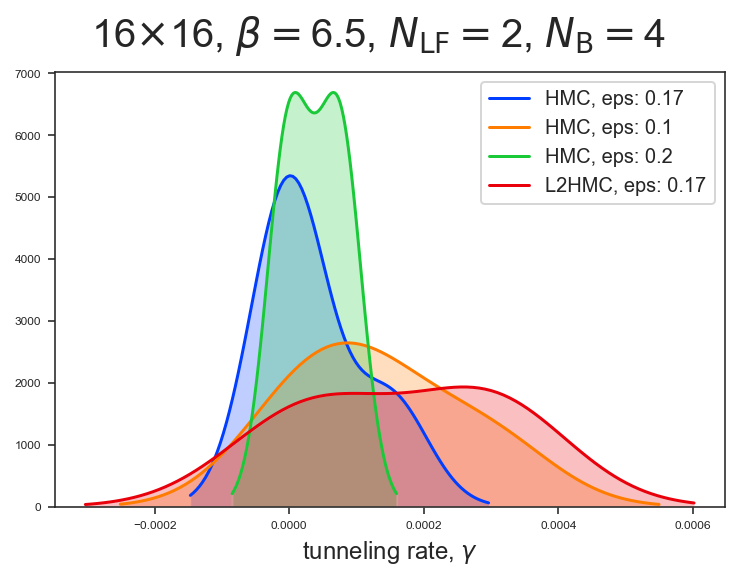

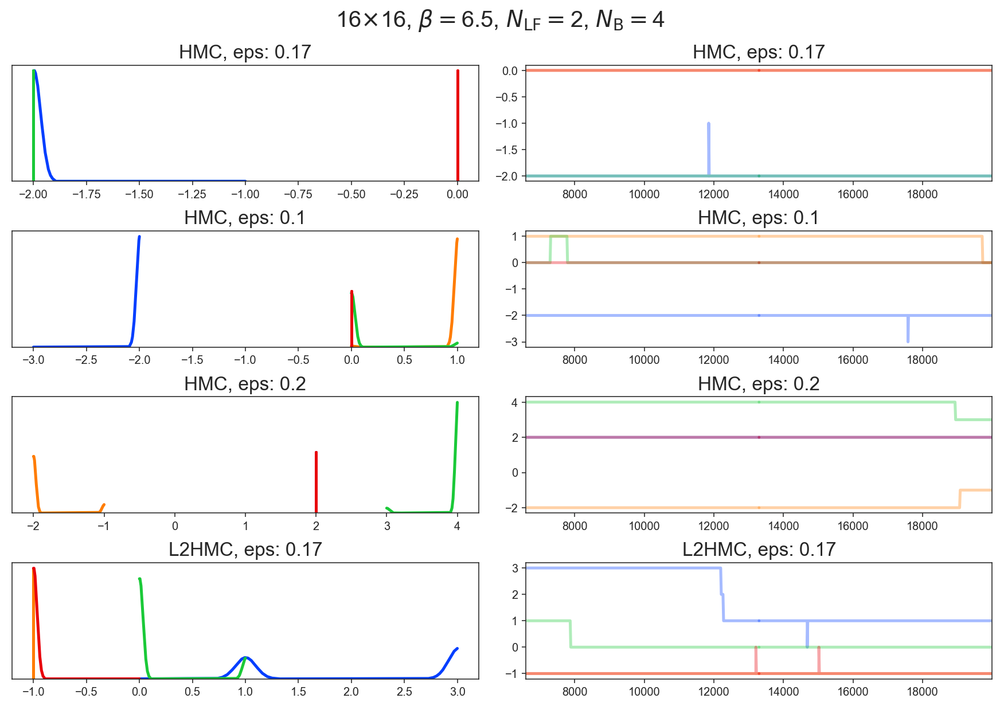

--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
filter_str: beta70
Unable to locate `runs_tf`. Trying with `runs_np`...


/Users/saforem2/opt/anaconda3/envs/tf2/lib/python3.6/site-packages/seaborn/distributions.py:288: UserWarning: Data must have variance to compute a kernel density estimate.
  warnings.warn(msg, UserWarning)
/Users/saforem2/opt/anaconda3/envs/tf2/lib/python3.6/site-packages/seaborn/distributions.py:288: UserWarning: Data must have variance to compute a kernel density estimate.
  warnings.warn(msg, UserWarning)
/Users/saforem2/opt/anaconda3/envs/tf2/lib/python3.6/site-packages/seaborn/distributions.py:288: UserWarning: Data must have variance to compute a kernel density estimate.
  warnings.warn(msg, UserWarning)
/Users/saforem2/opt/anaconda3/envs/tf2/lib/python3.6/site-packages/seaborn/distributions.py:288: UserWarning: Data must have variance to compute a kernel density estimate.
  warnings.warn(msg, UserWarning)


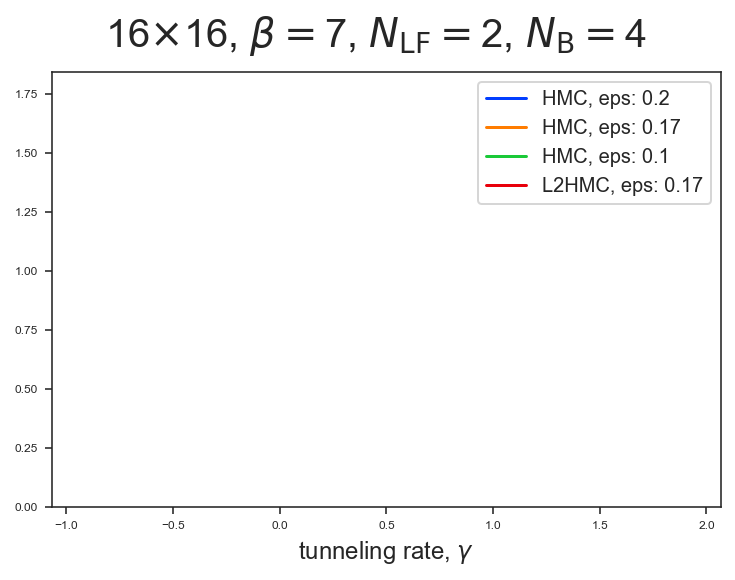

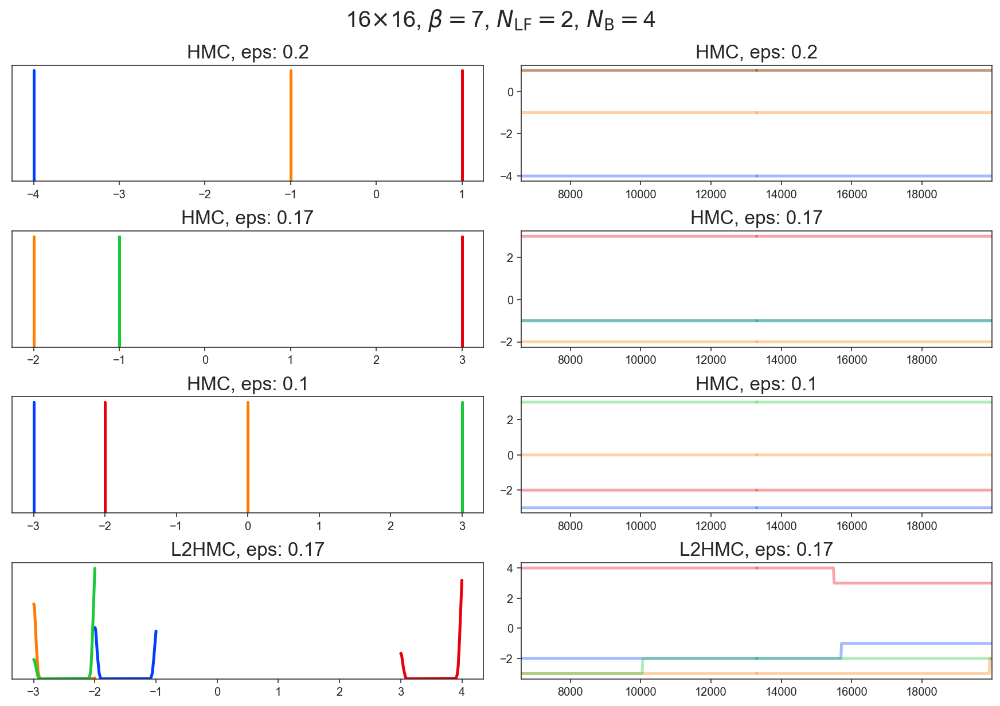

/Users/saforem2/opt/anaconda3/envs/tf2/lib/python3.6/site-packages/seaborn/distributions.py:288: UserWarning: Data must have variance to compute a kernel density estimate.
  warnings.warn(msg, UserWarning)
/Users/saforem2/opt/anaconda3/envs/tf2/lib/python3.6/site-packages/seaborn/distributions.py:288: UserWarning: Data must have variance to compute a kernel density estimate.
  warnings.warn(msg, UserWarning)
/Users/saforem2/opt/anaconda3/envs/tf2/lib/python3.6/site-packages/seaborn/distributions.py:288: UserWarning: Data must have variance to compute a kernel density estimate.
  warnings.warn(msg, UserWarning)
/Users/saforem2/opt/anaconda3/envs/tf2/lib/python3.6/site-packages/seaborn/distributions.py:288: UserWarning: Data must have variance to compute a kernel density estimate.
  warnings.warn(msg, UserWarning)


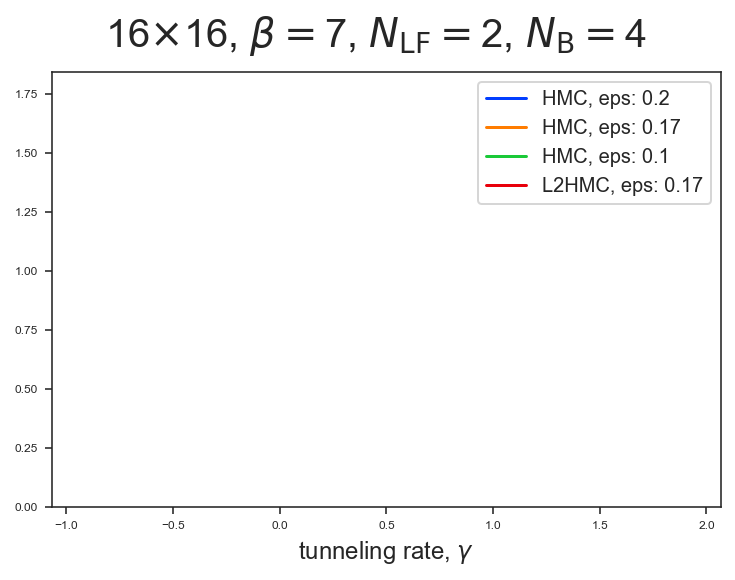

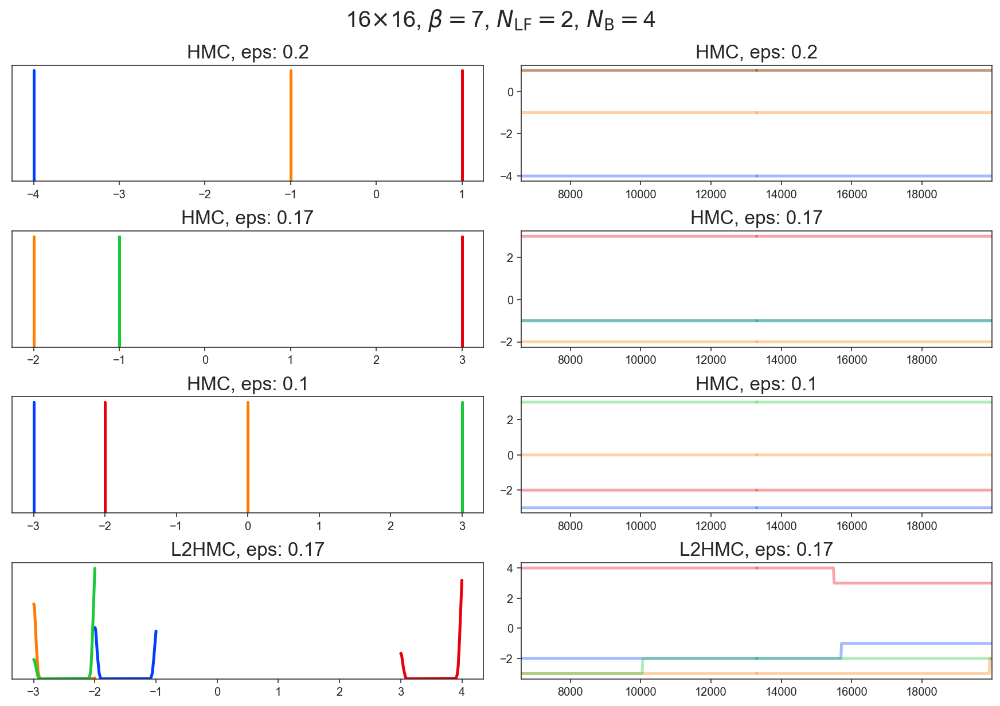

--------------------------------------------------------------------------------
********************************************************************************


********************************************************************************
log_dir: /Users/saforem2/l2hmc-qcd/gauge_logs/gce_logs/2020_05_13/L16_b1024_lf4_GaugeNetwork_aw00_qw01_pw01_dp05_f32_1252
--------------------------------------------------------------------------------
filter_str: beta50
--------------------------------------------------------------------------------
filter_str: beta55
--------------------------------------------------------------------------------
filter_str: beta60
--------------------------------------------------------------------------------
filter_str: beta65
--------------------------------------------------------------------------------
filter_str: beta70
********************************************************************************


**************************************************

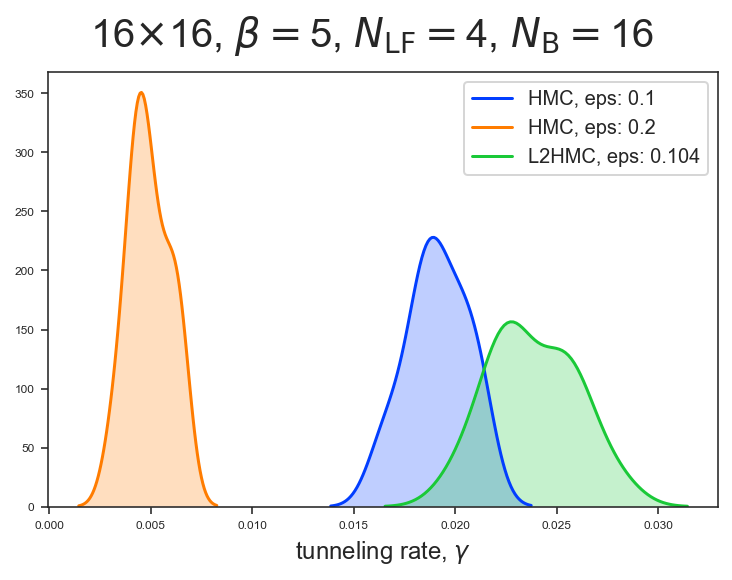

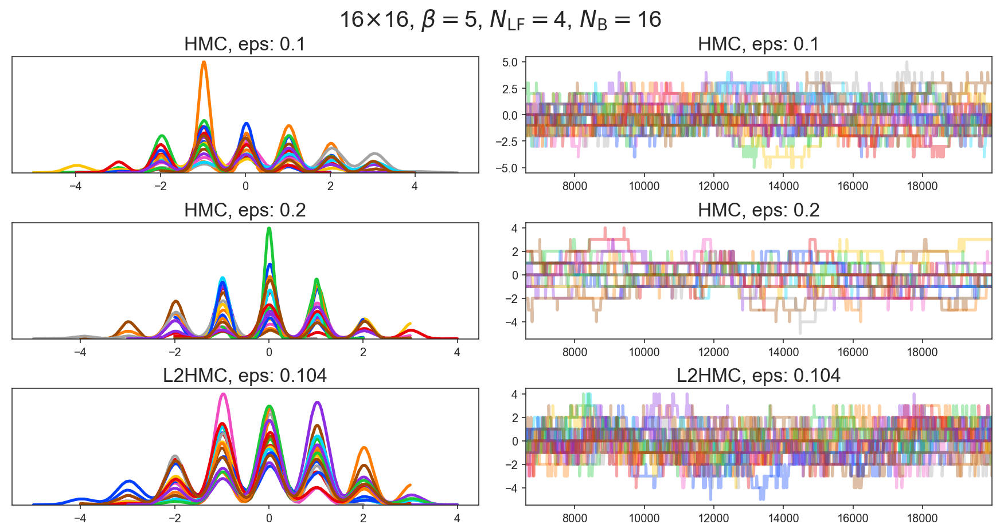

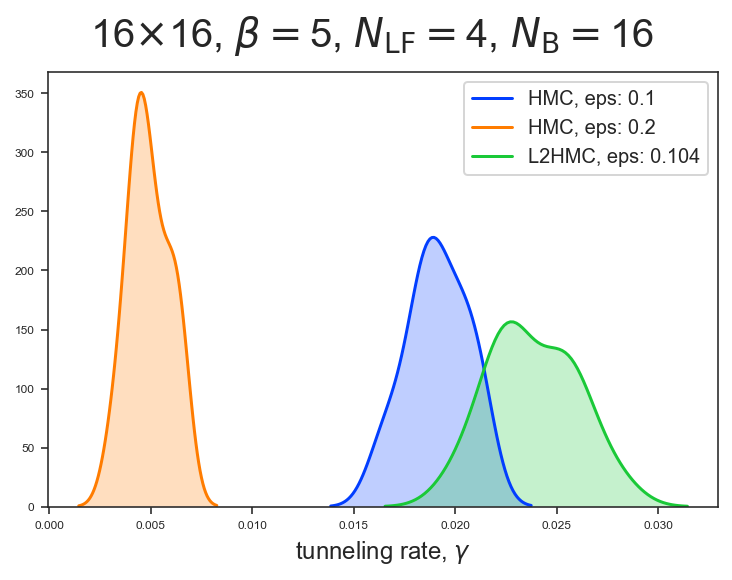

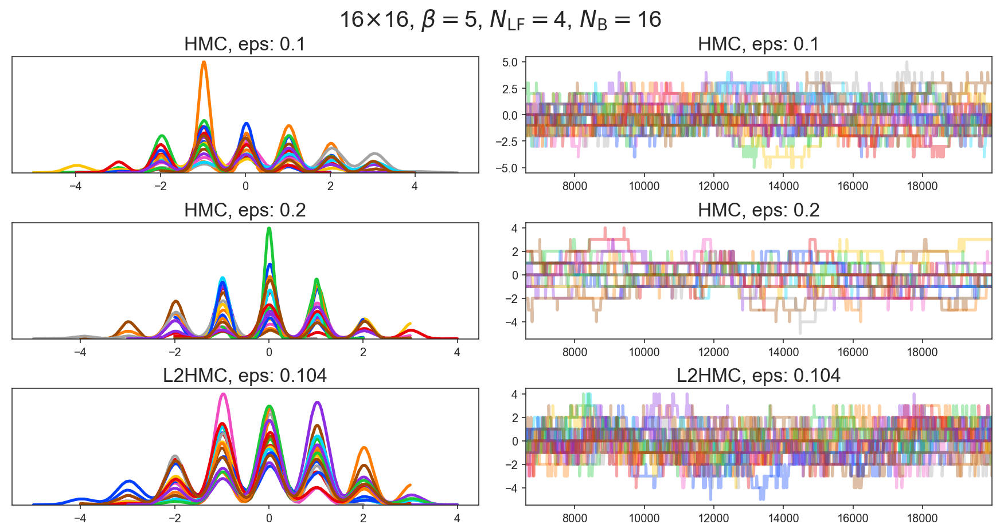

--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
filter_str: beta55
Unable to locate `runs_tf`. Trying with `runs_np`...


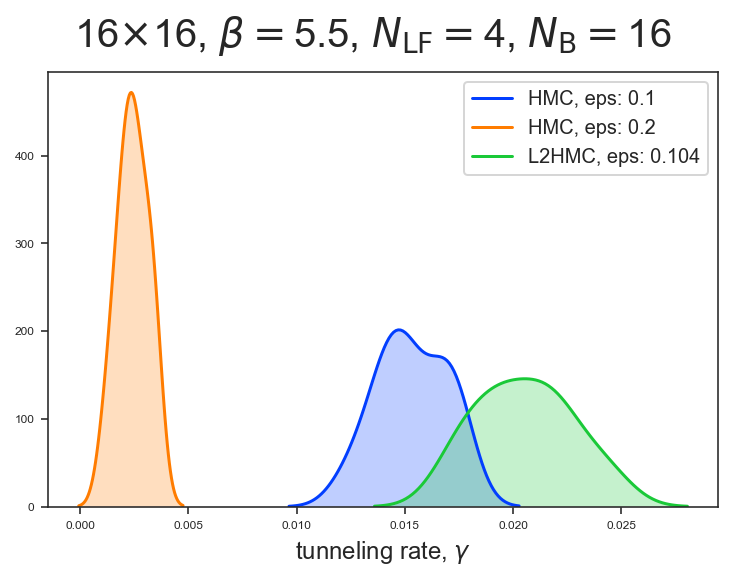

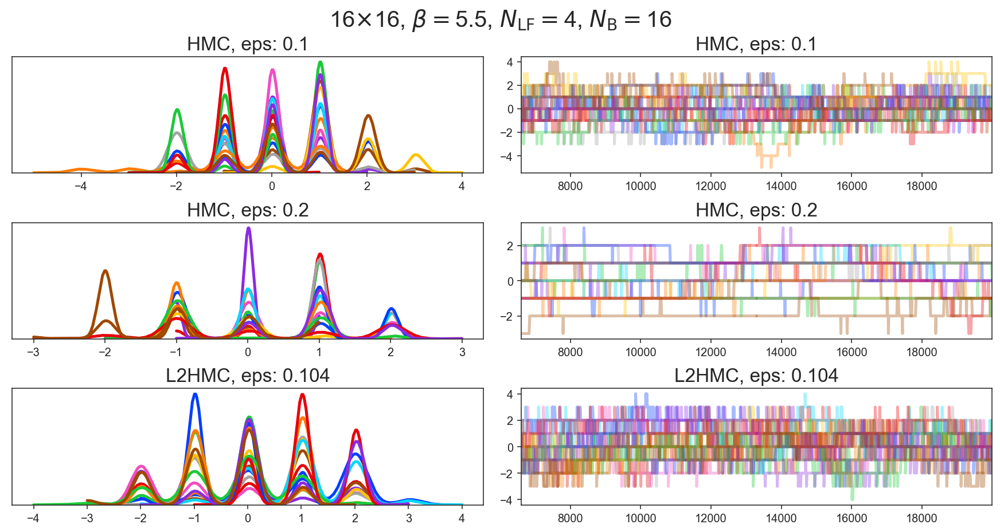

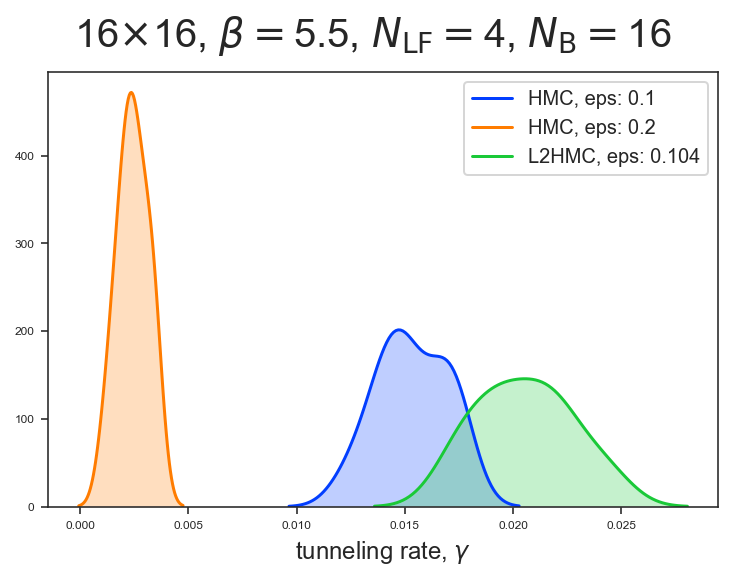

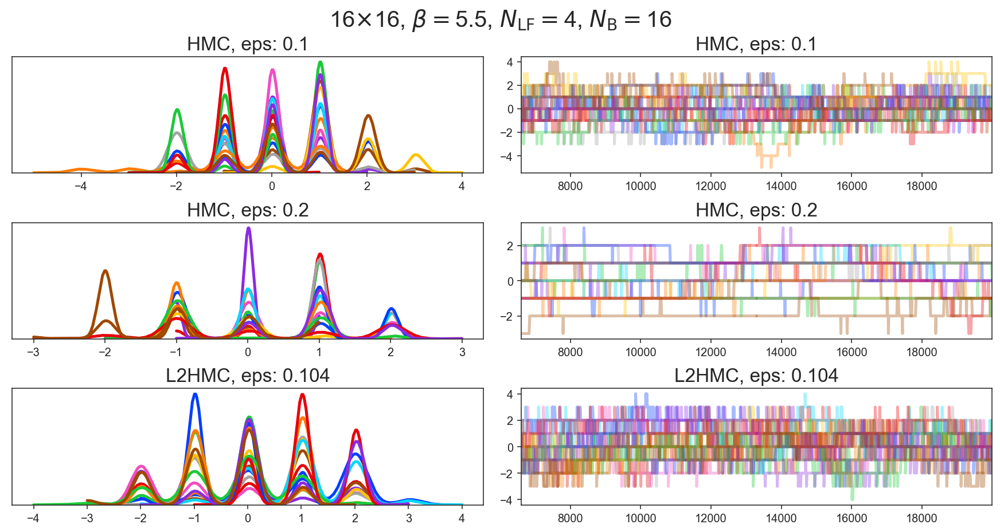

--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
filter_str: beta575
Unable to locate `runs_tf`. Trying with `runs_np`...


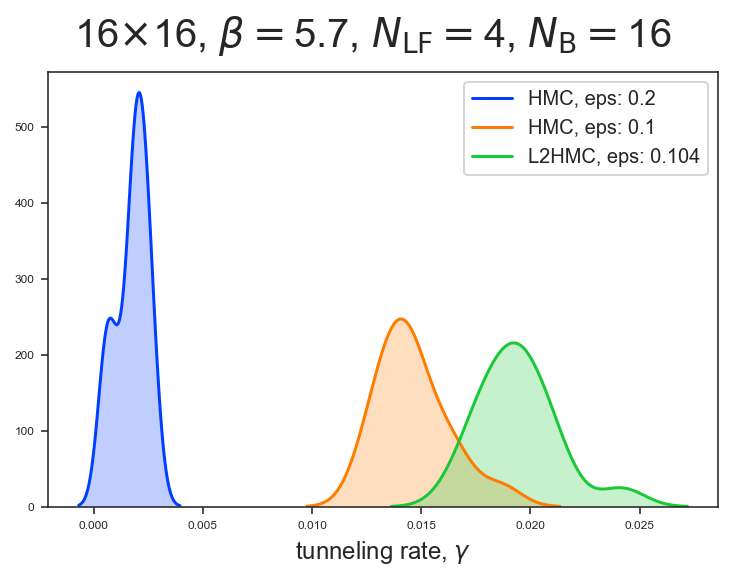

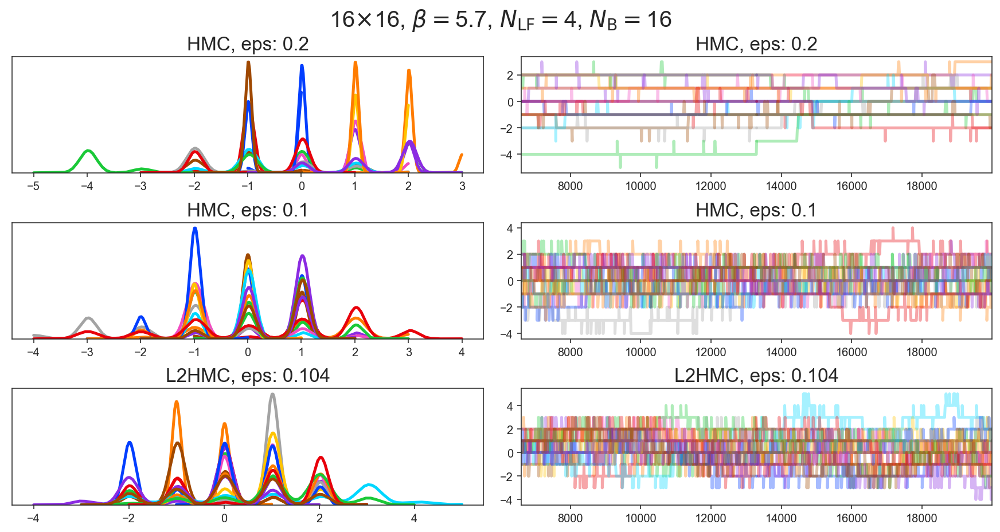

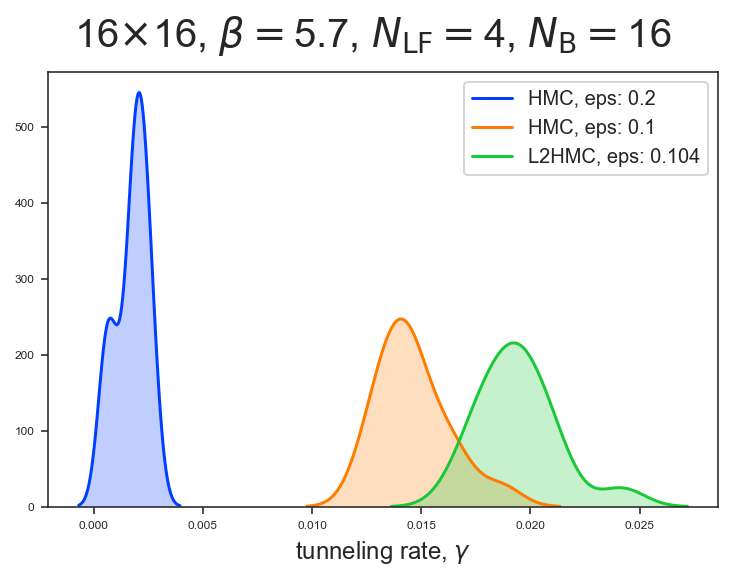

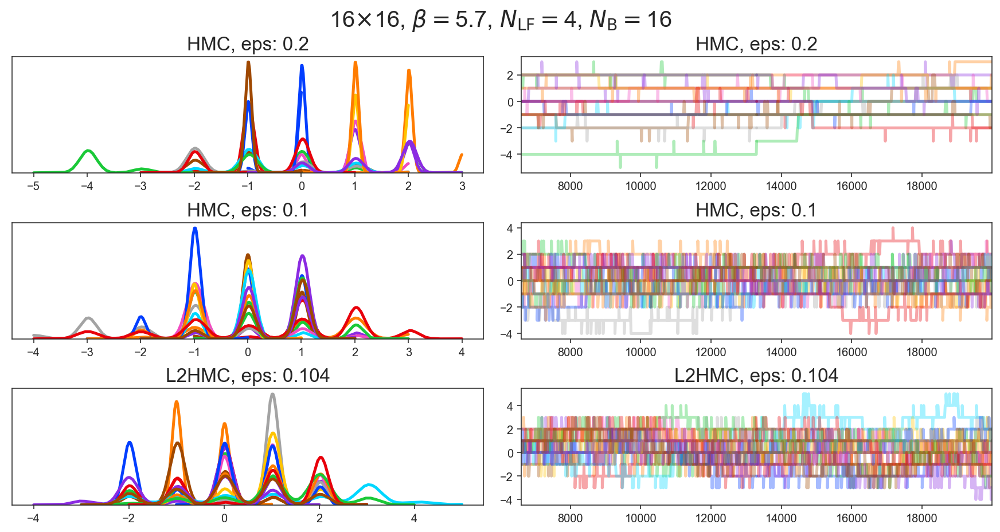

--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
filter_str: beta60
Unable to locate `runs_tf`. Trying with `runs_np`...


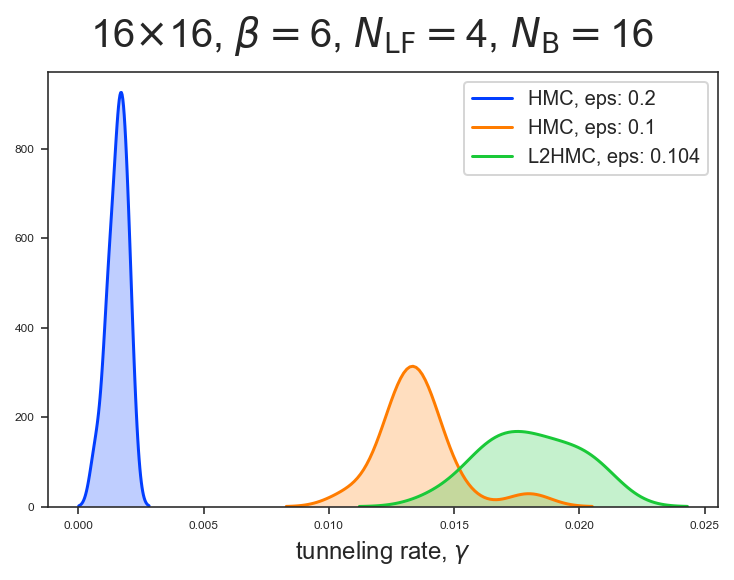

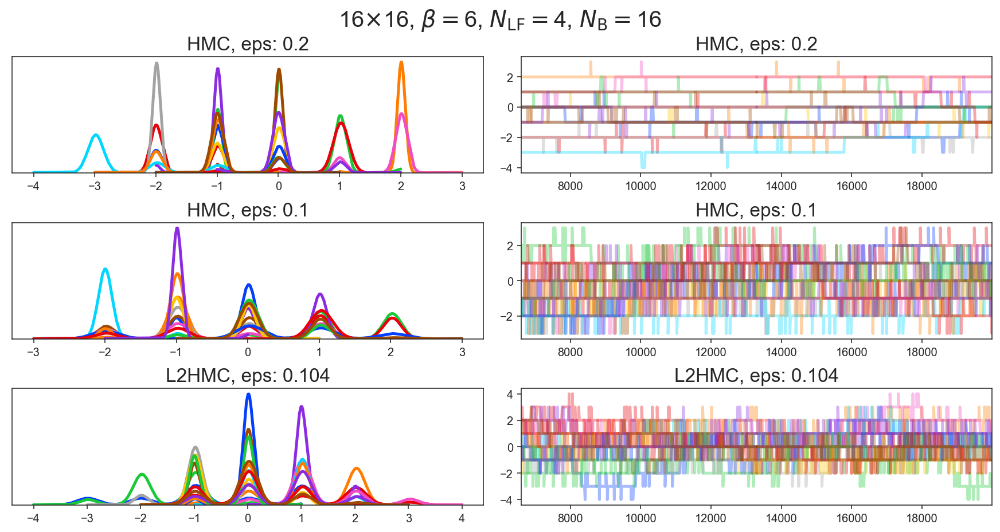

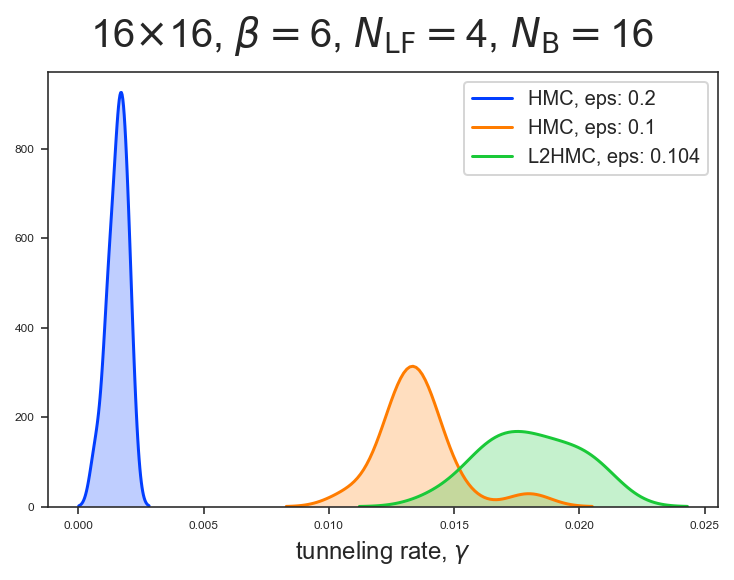

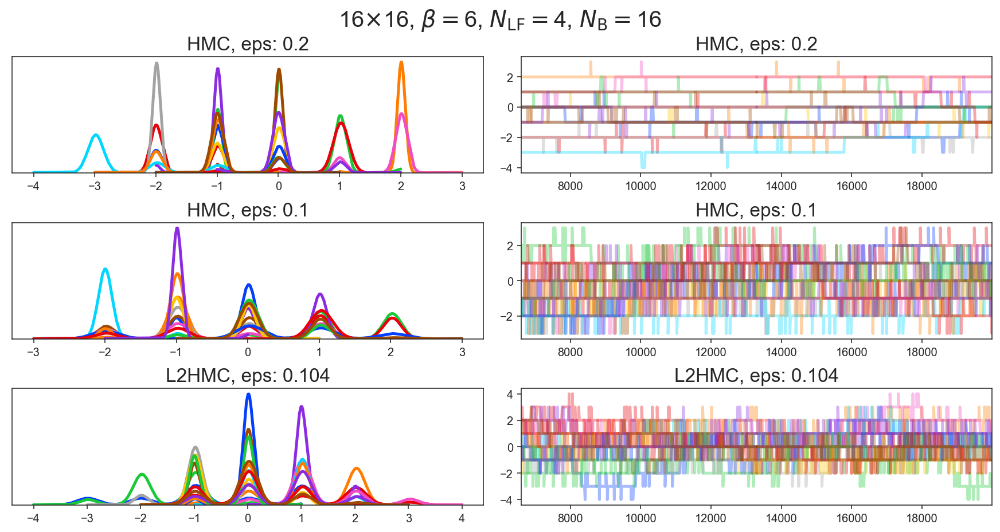

--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
filter_str: beta625
Unable to locate `runs_tf`. Trying with `runs_np`...


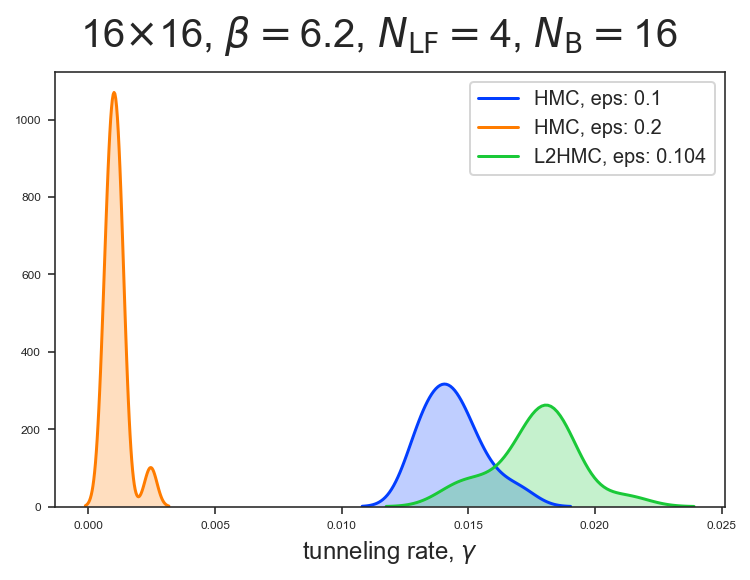

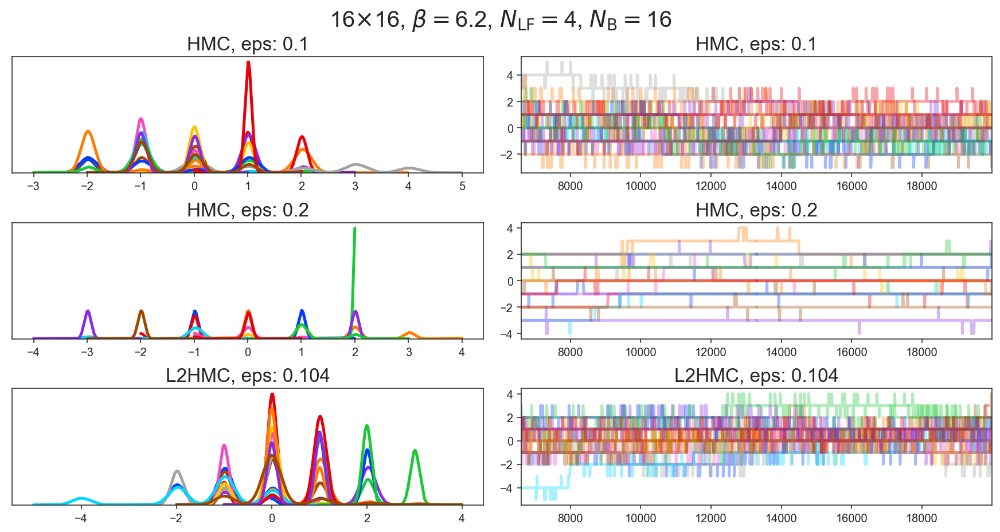

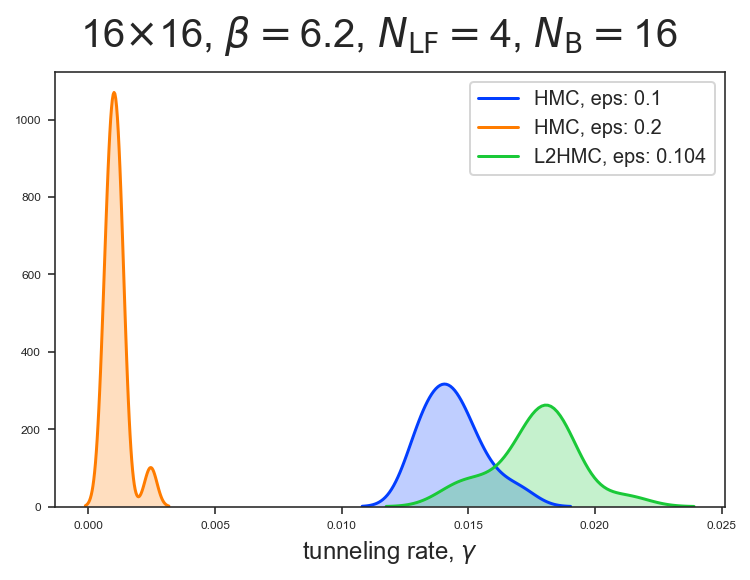

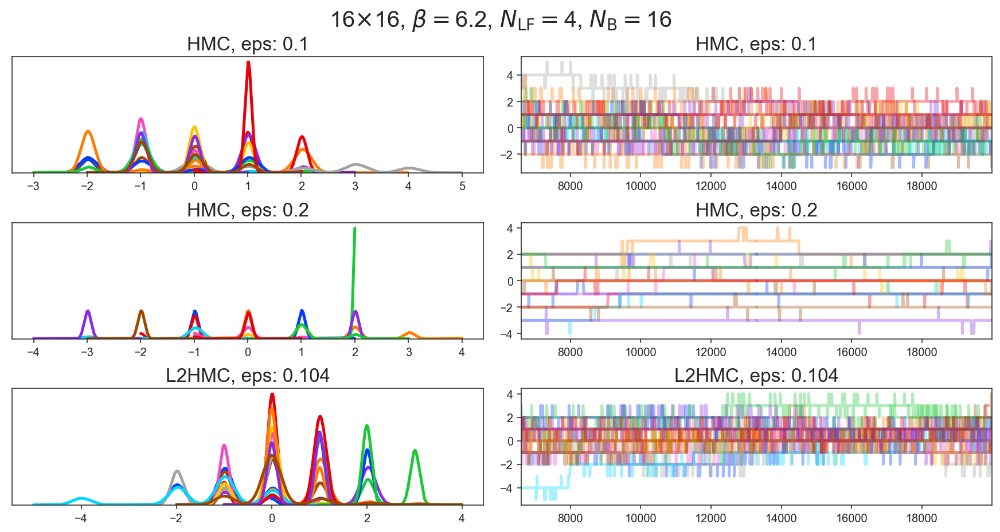

--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
filter_str: beta65
Unable to locate `runs_tf`. Trying with `runs_np`...


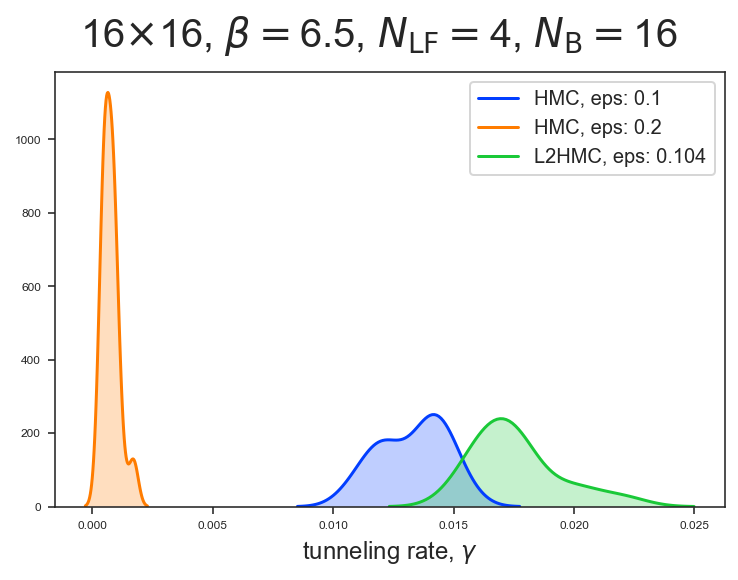

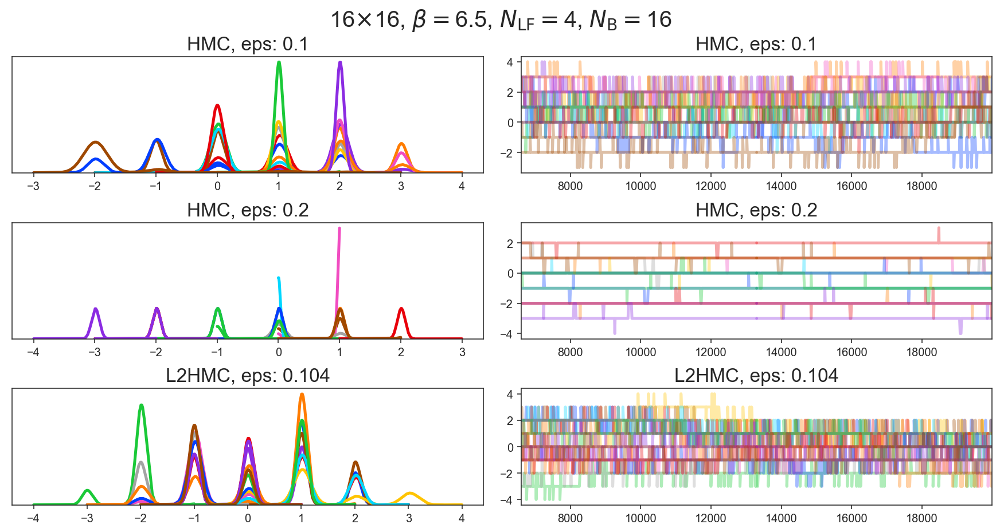

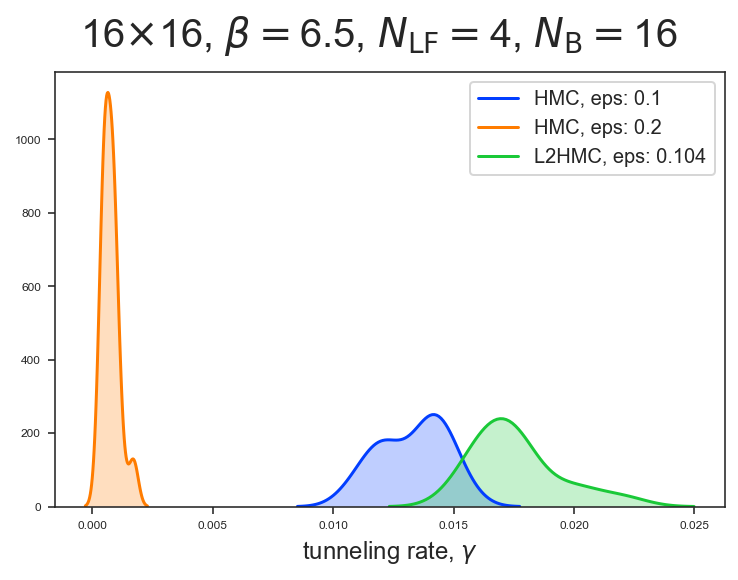

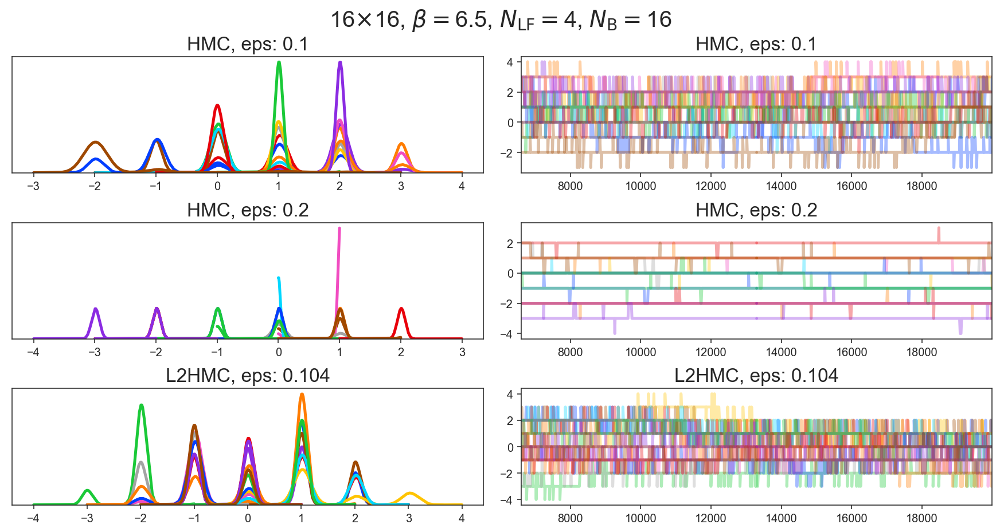

--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
filter_str: beta70
Unable to locate `runs_tf`. Trying with `runs_np`...


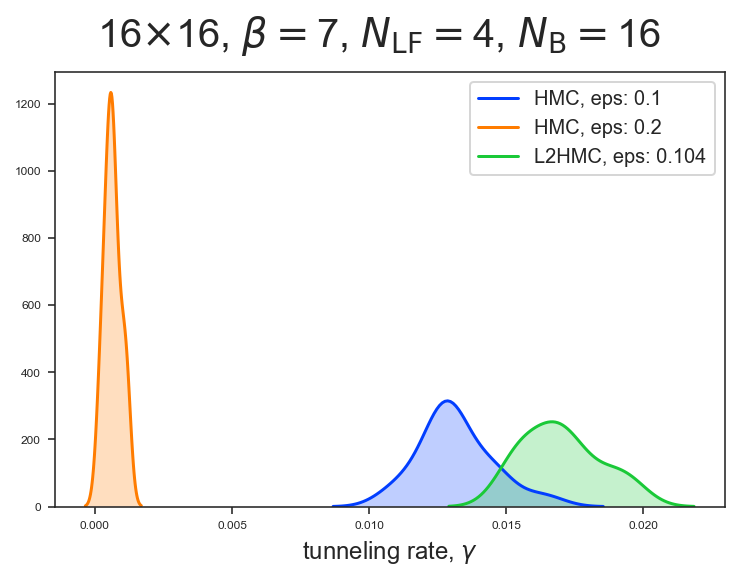

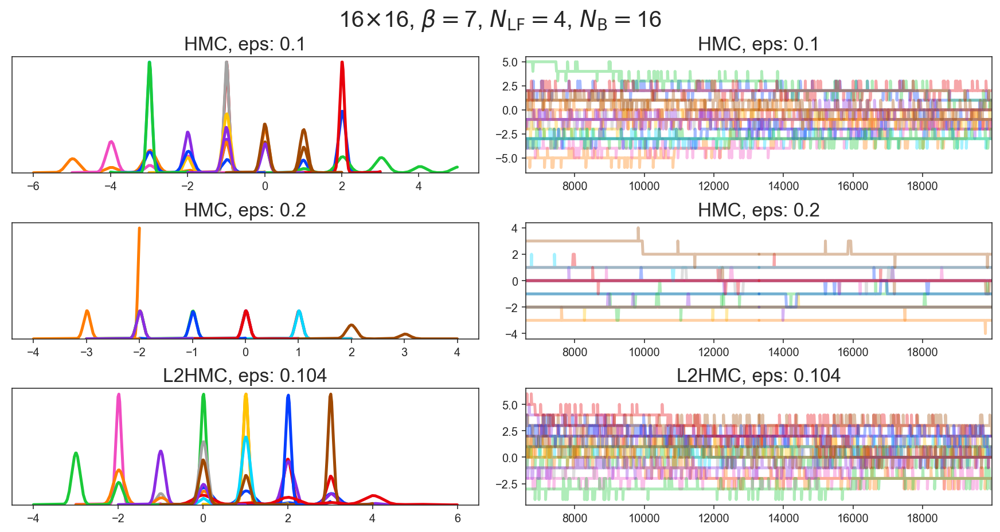

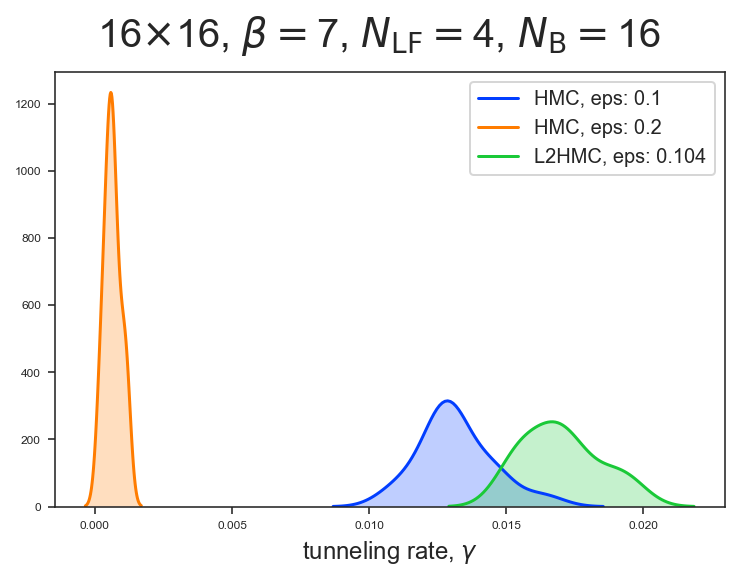

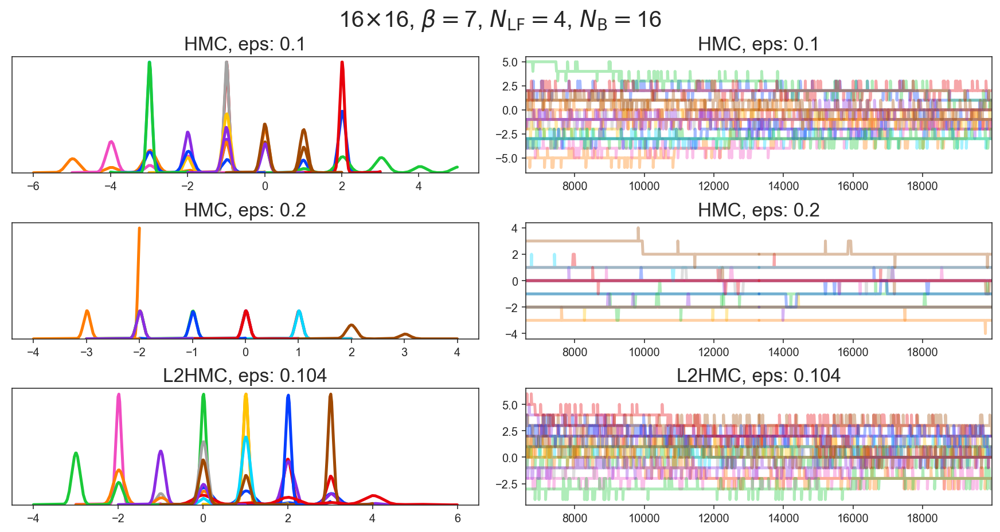

--------------------------------------------------------------------------------
********************************************************************************


********************************************************************************
log_dir: /Users/saforem2/l2hmc-qcd/gauge_logs/gce_logs/2020_05_19/L16_b1024_lf5_GaugeNetwork_aw00_qw01_eps_fixed_f32_2313
--------------------------------------------------------------------------------
filter_str: beta50
Unable to locate `runs_tf`. Trying with `runs_np`...


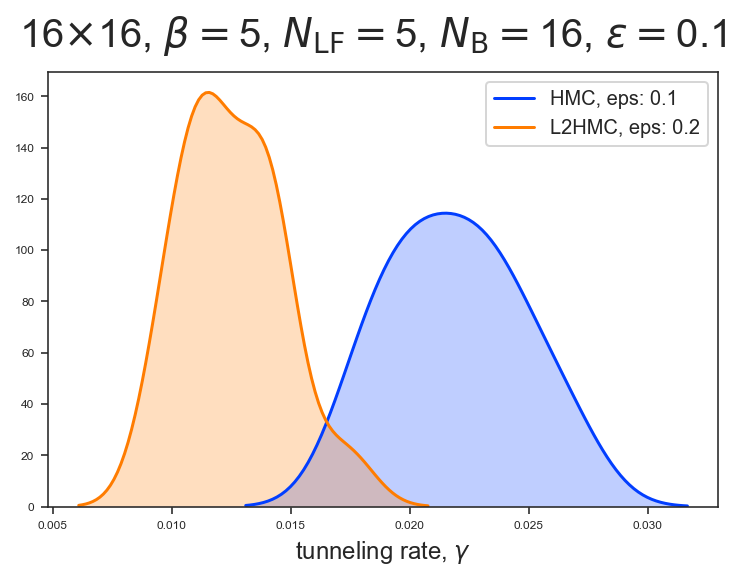

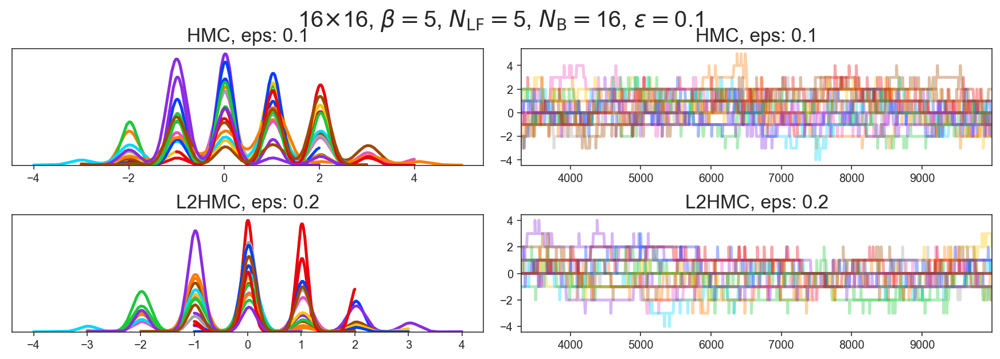

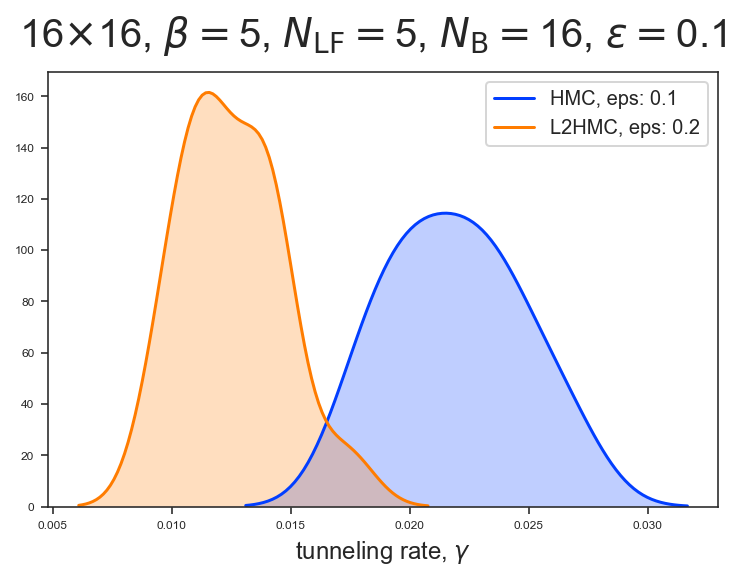

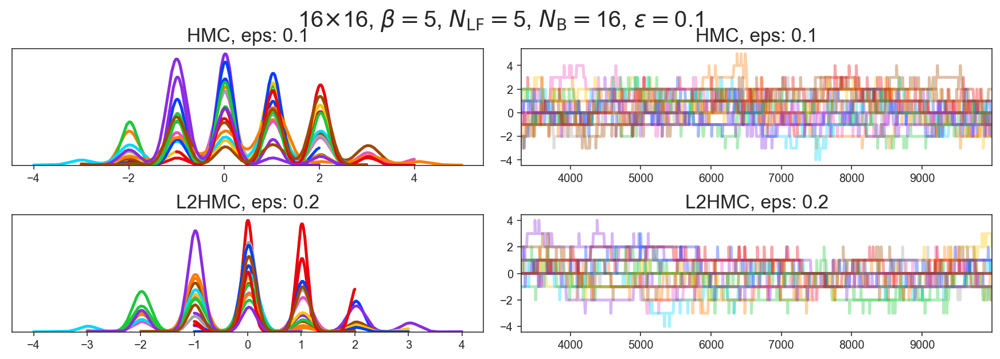

--------------------------------------------------------------------------------
********************************************************************************


********************************************************************************
log_dir: /Users/saforem2/l2hmc-qcd/gauge_logs/gce_logs/2020_04_28/L12_b128_lf2_GaugeNetwork_aw00_qw01_dp025_f32_1438
********************************************************************************


********************************************************************************
log_dir: /Users/saforem2/l2hmc-qcd/gauge_logs/cooley_logs/2020_05_14/old
********************************************************************************


********************************************************************************
log_dir: /Users/saforem2/l2hmc-qcd/gauge_logs/cooley_logs/2020_05_14/L16_b2048_lf2_GaugeNetwork_aw00_qw01_pw01_dp05_f32_2213_1
********************************************************************************


***************************

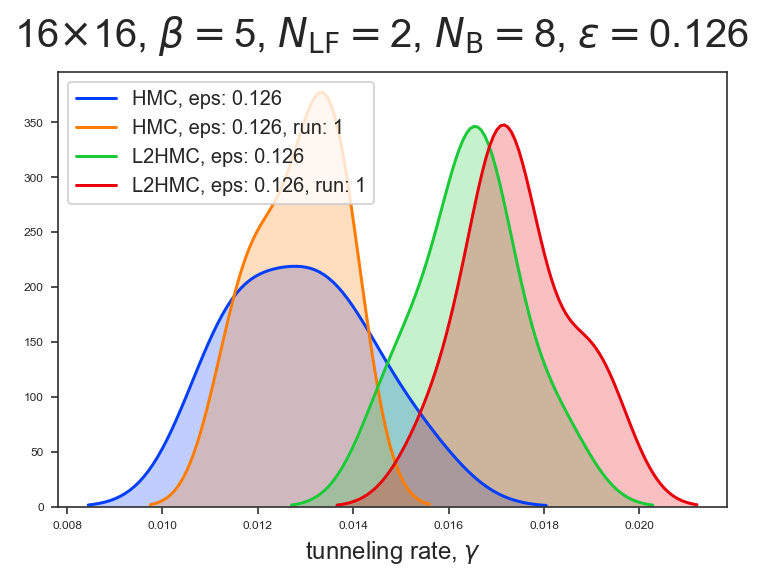

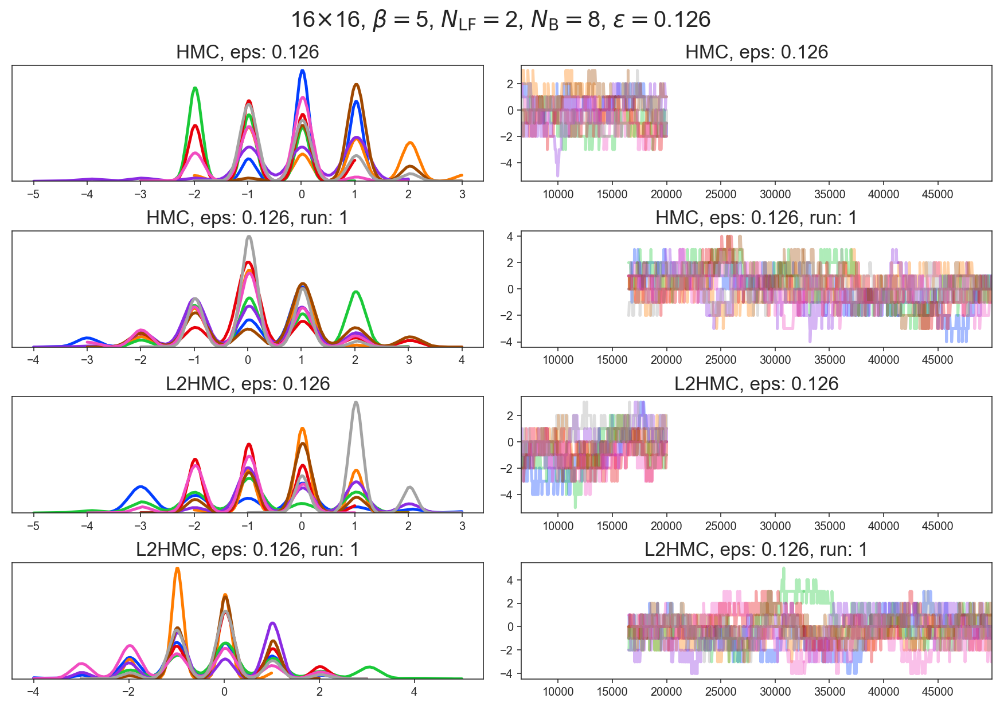

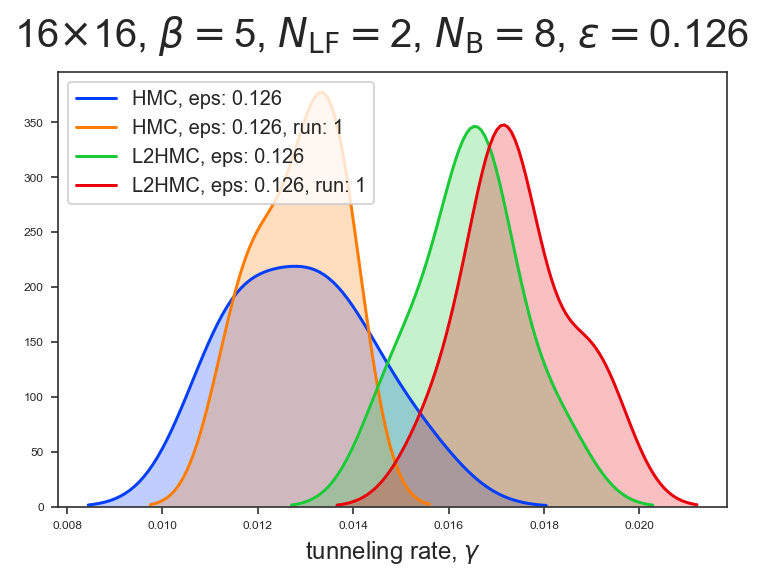

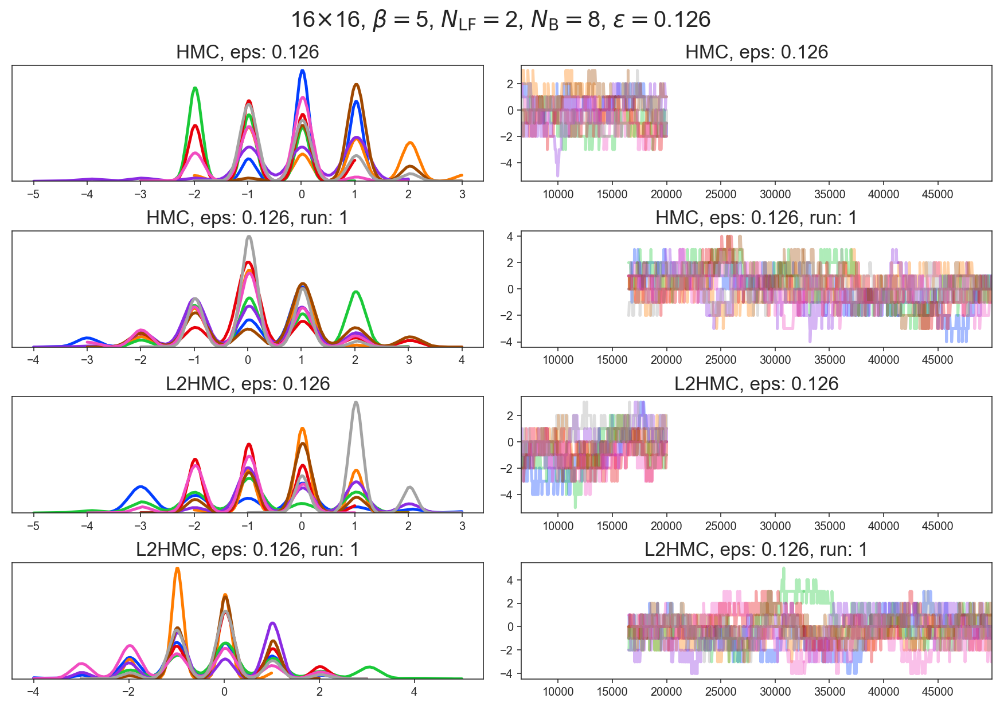

--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
filter_str: beta55
Unable to locate `runs_tf`. Trying with `runs_np`...


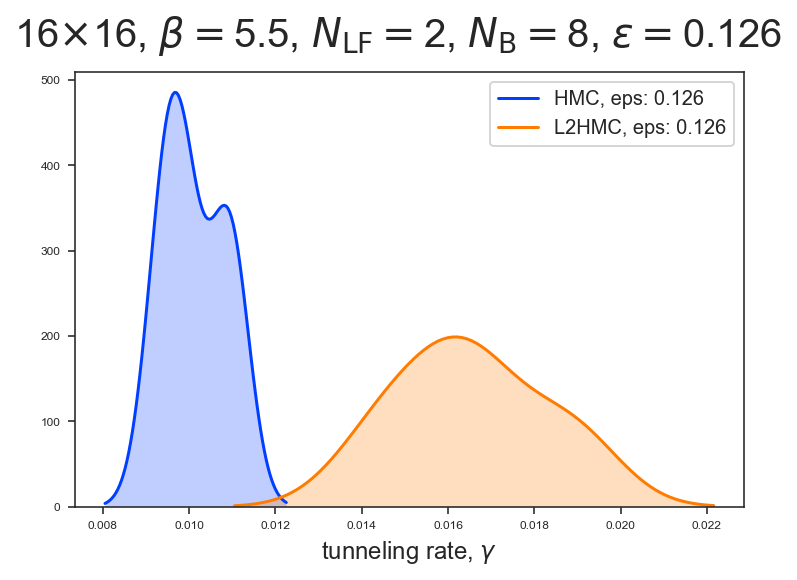

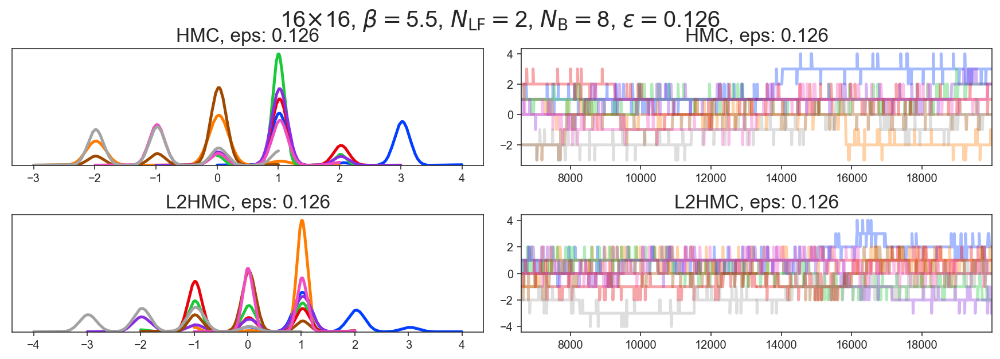

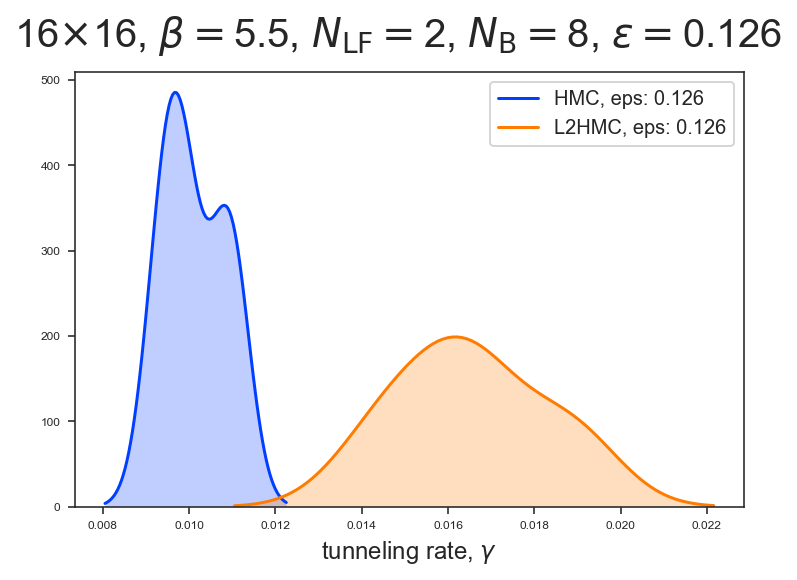

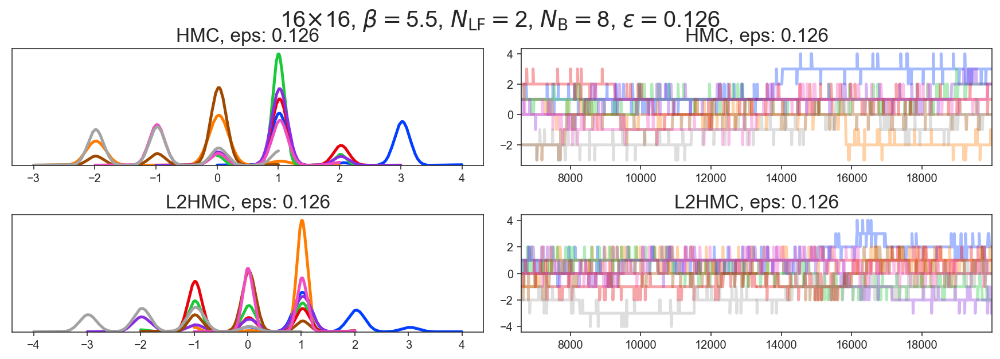

--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
filter_str: beta60
Unable to locate `runs_tf`. Trying with `runs_np`...


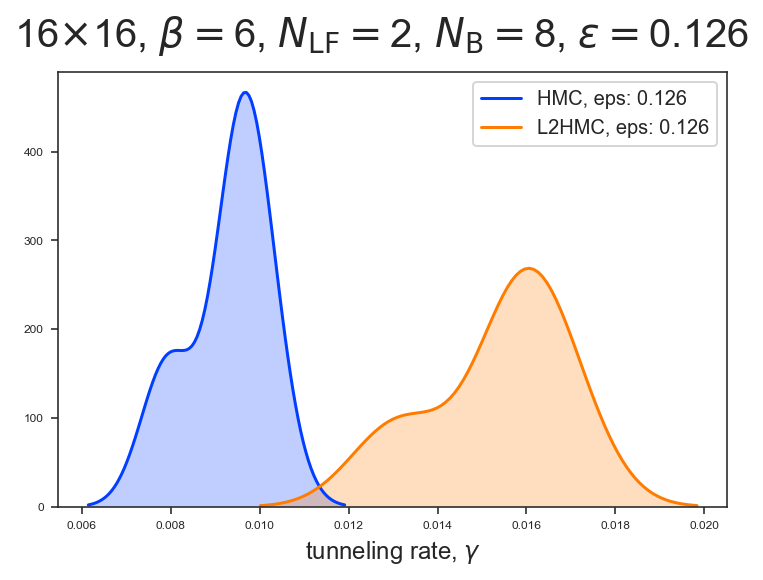

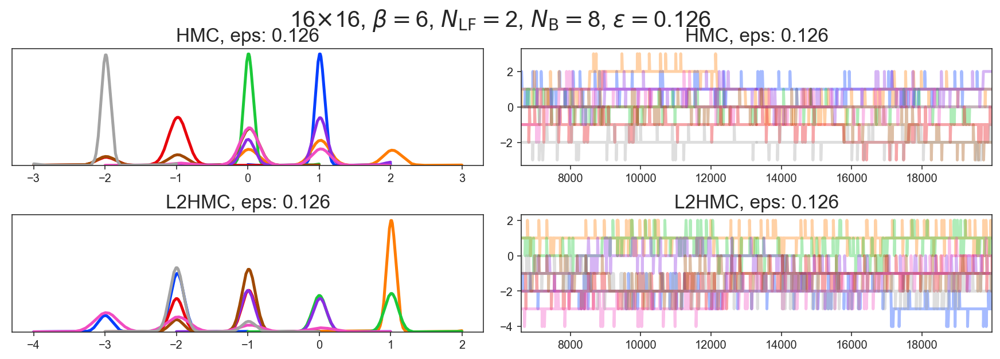

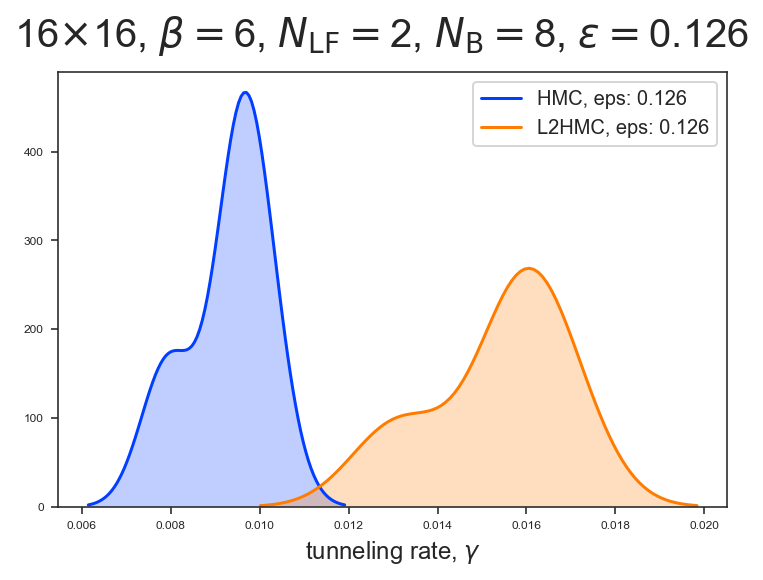

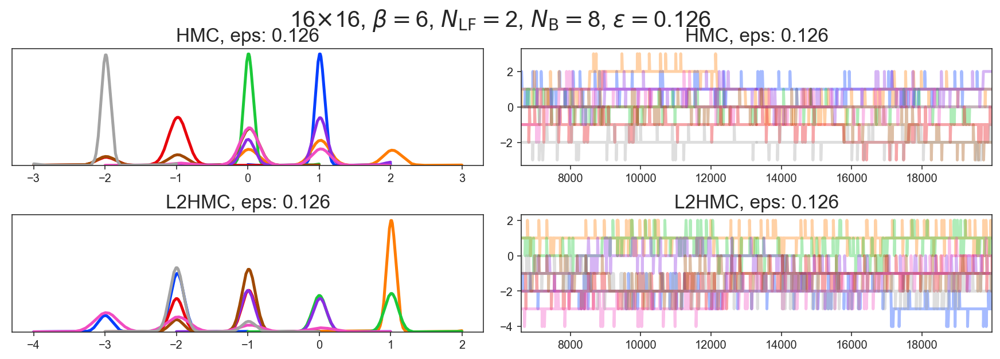

--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
filter_str: beta65
Unable to locate `runs_tf`. Trying with `runs_np`...


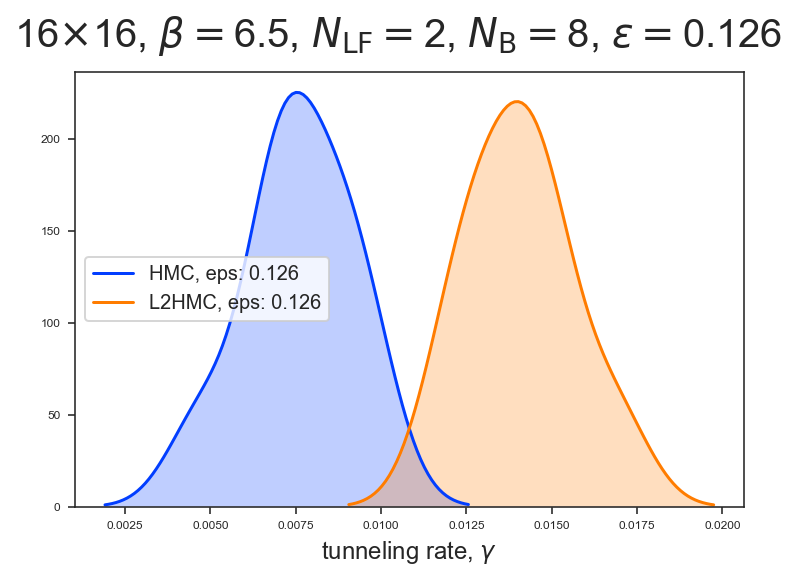

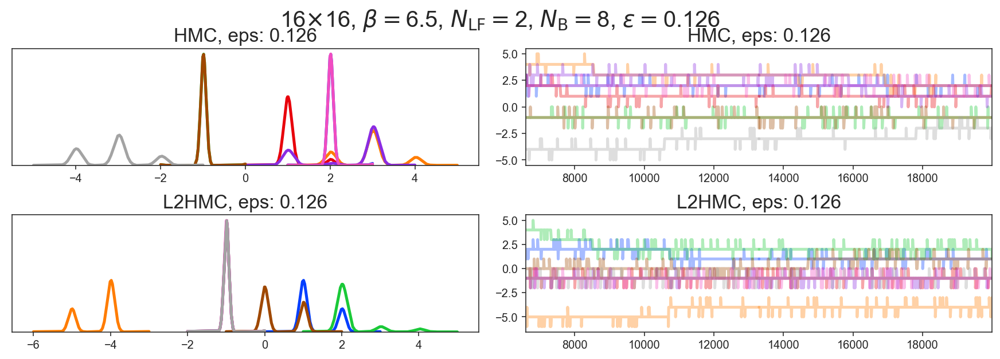

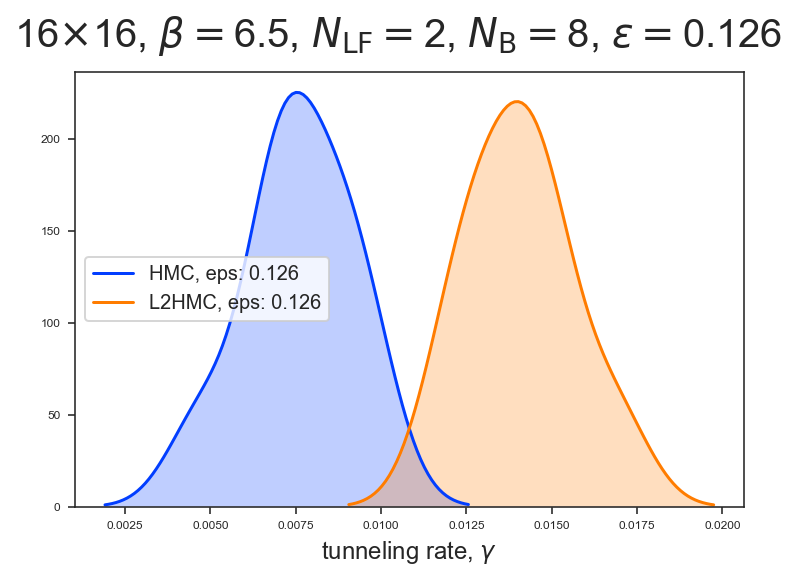

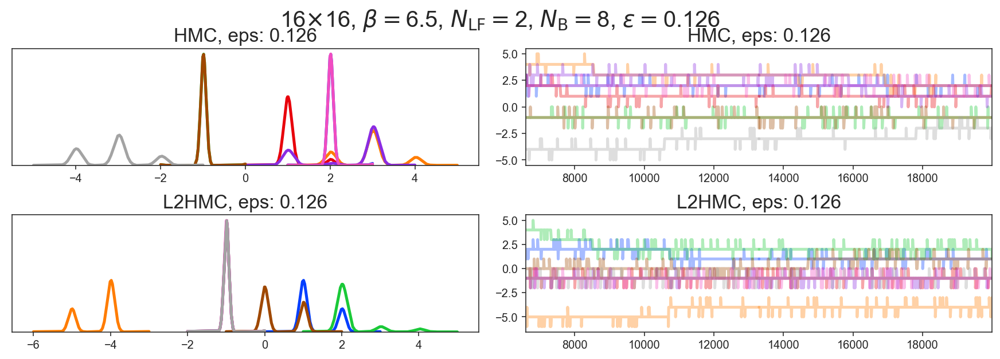

--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
filter_str: beta70
Unable to locate `runs_tf`. Trying with `runs_np`...


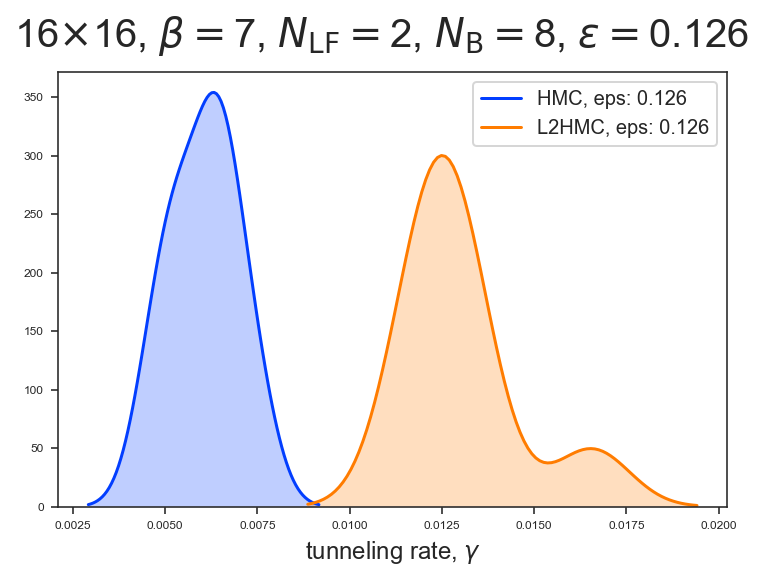

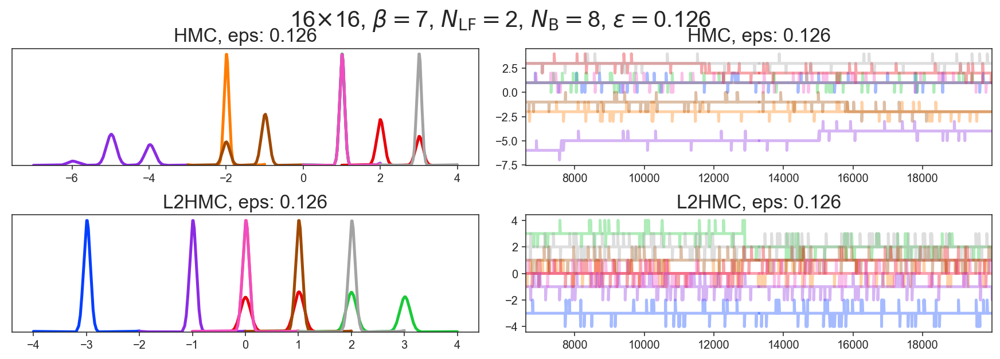

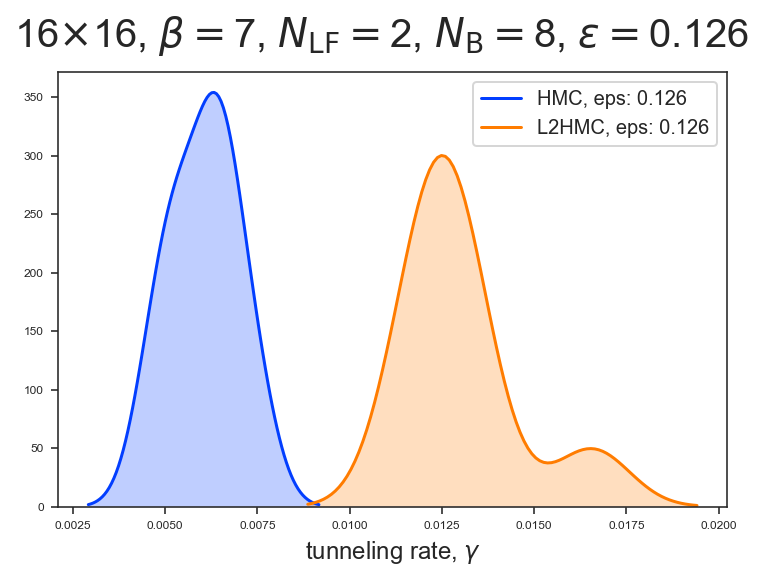

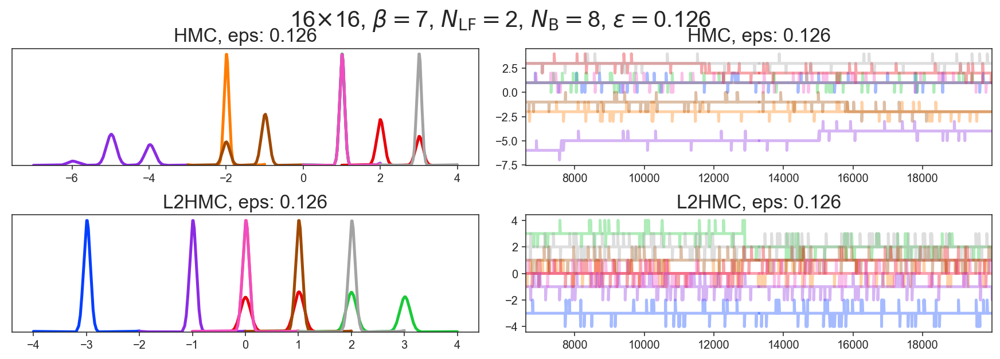

--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
filter_str: beta75
Unable to locate `runs_tf`. Trying with `runs_np`...


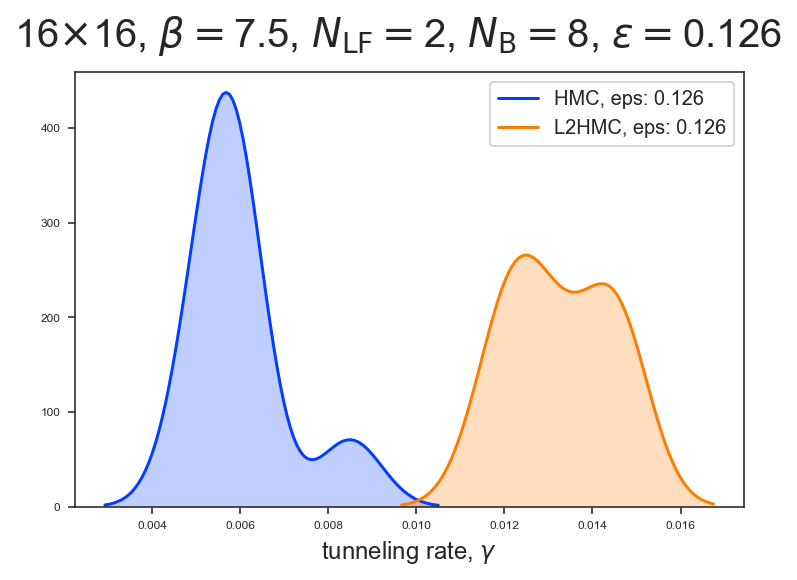

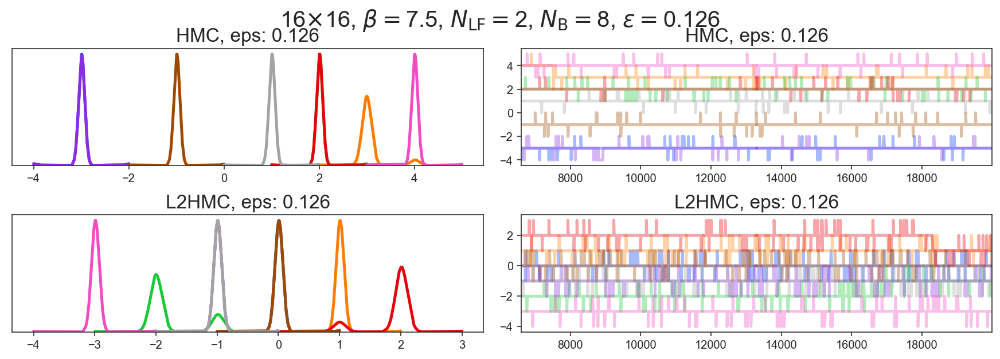

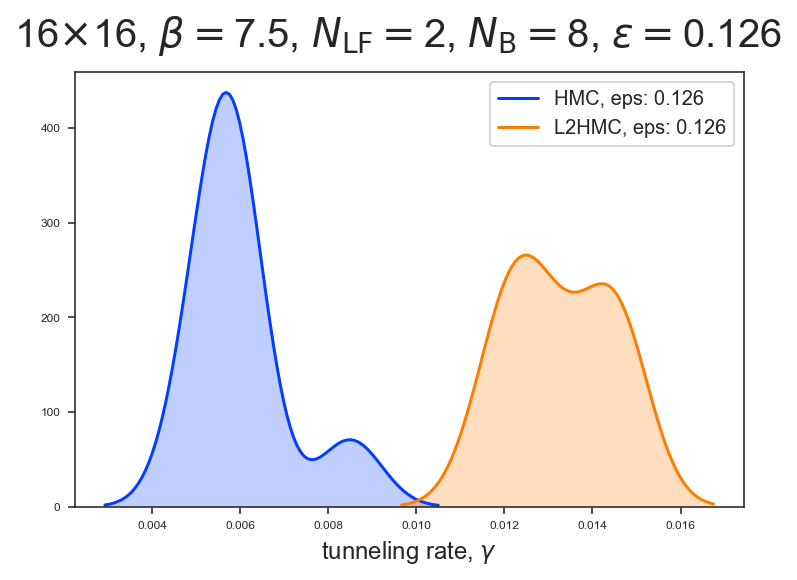

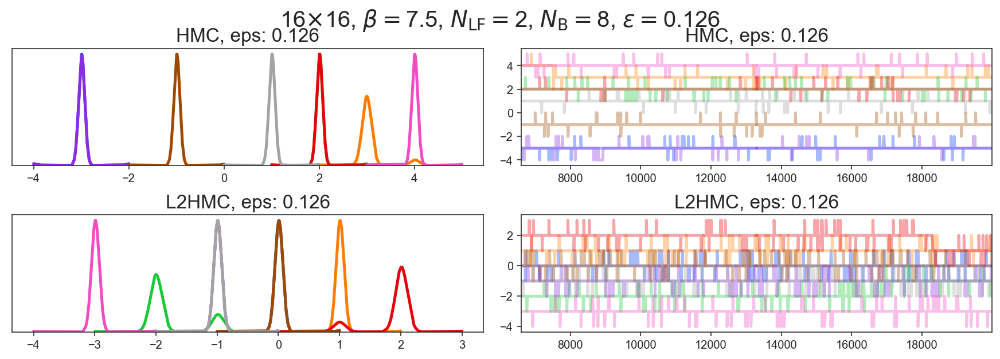

--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
filter_str: beta80
Unable to locate `runs_tf`. Trying with `runs_np`...


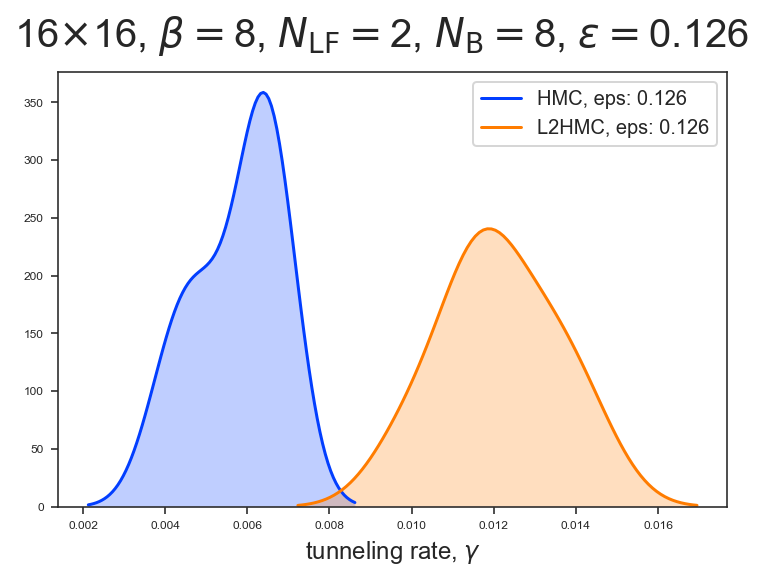

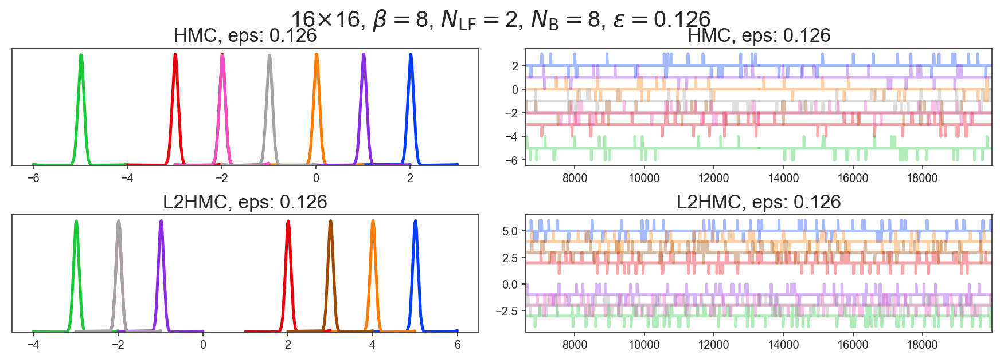

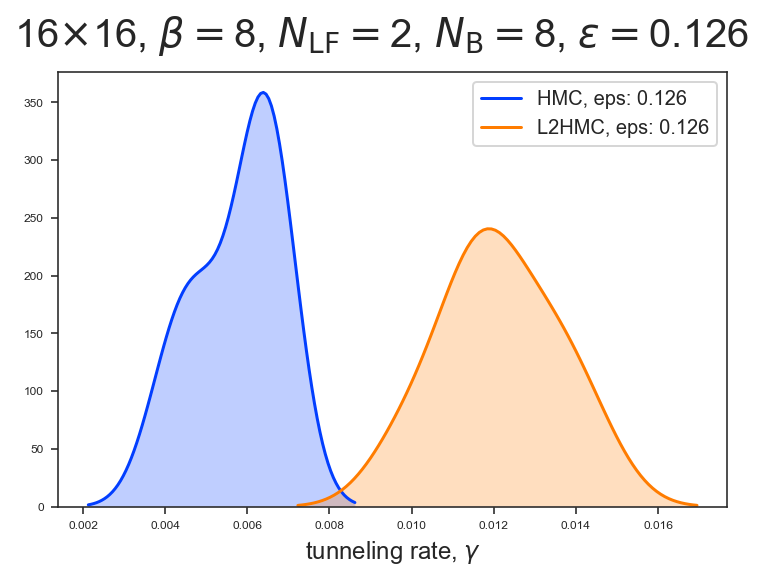

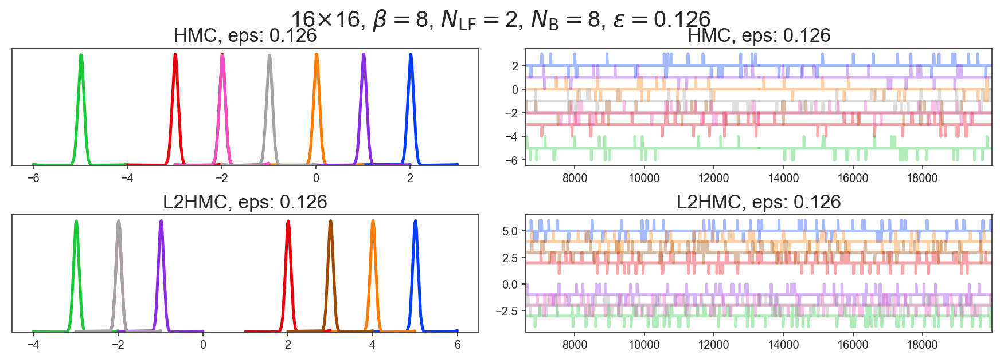

--------------------------------------------------------------------------------
********************************************************************************


********************************************************************************
log_dir: /Users/saforem2/l2hmc-qcd/gauge_logs/cooley_logs/2020_05_13/old
********************************************************************************


********************************************************************************
log_dir: /Users/saforem2/l2hmc-qcd/gauge_logs/cooley_logs/2020_05_06/L16_b1024_lf2_GaugeNetwork_aw00_qw01_dp025_f32_2305_1
--------------------------------------------------------------------------------
filter_str: beta50
Unable to locate `runs_tf`. Trying with `runs_np`...


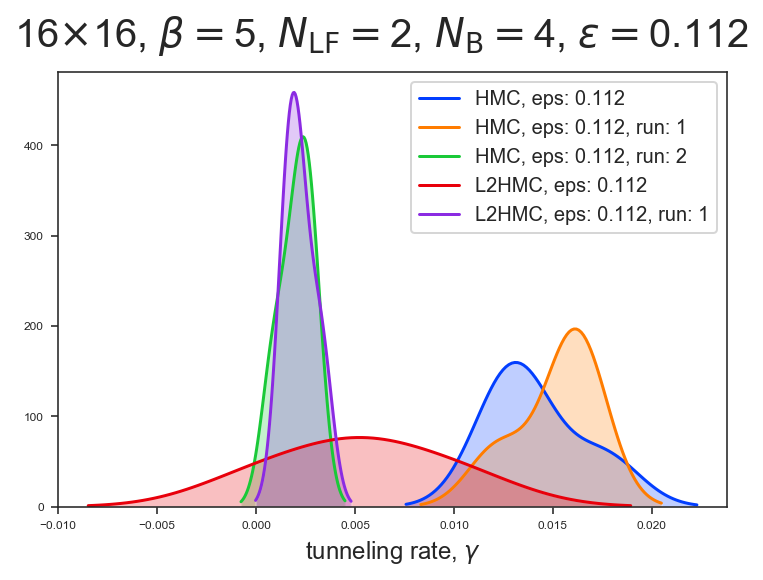

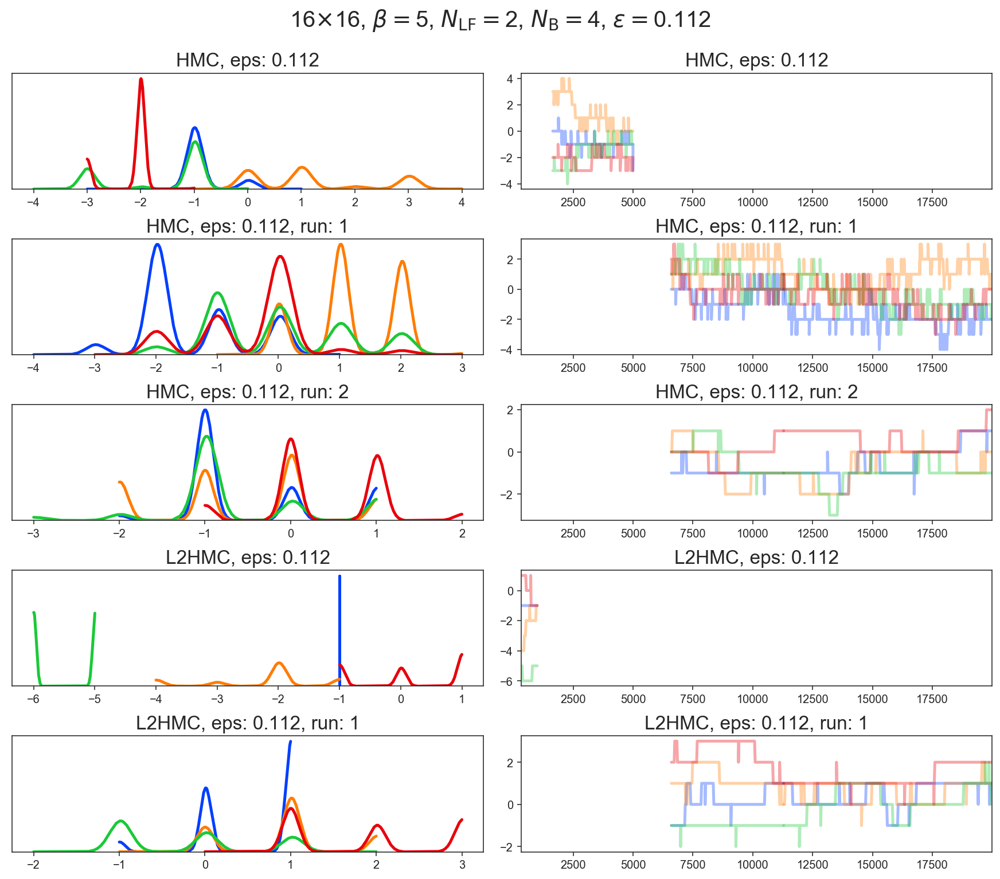

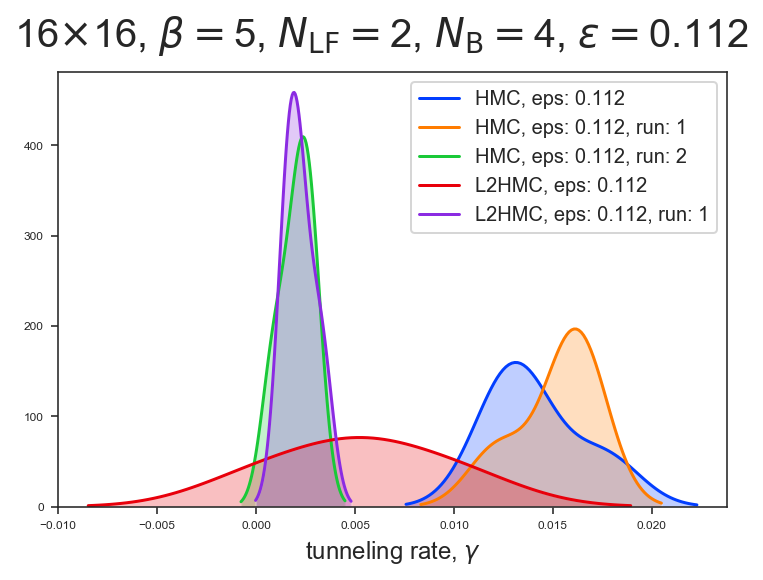

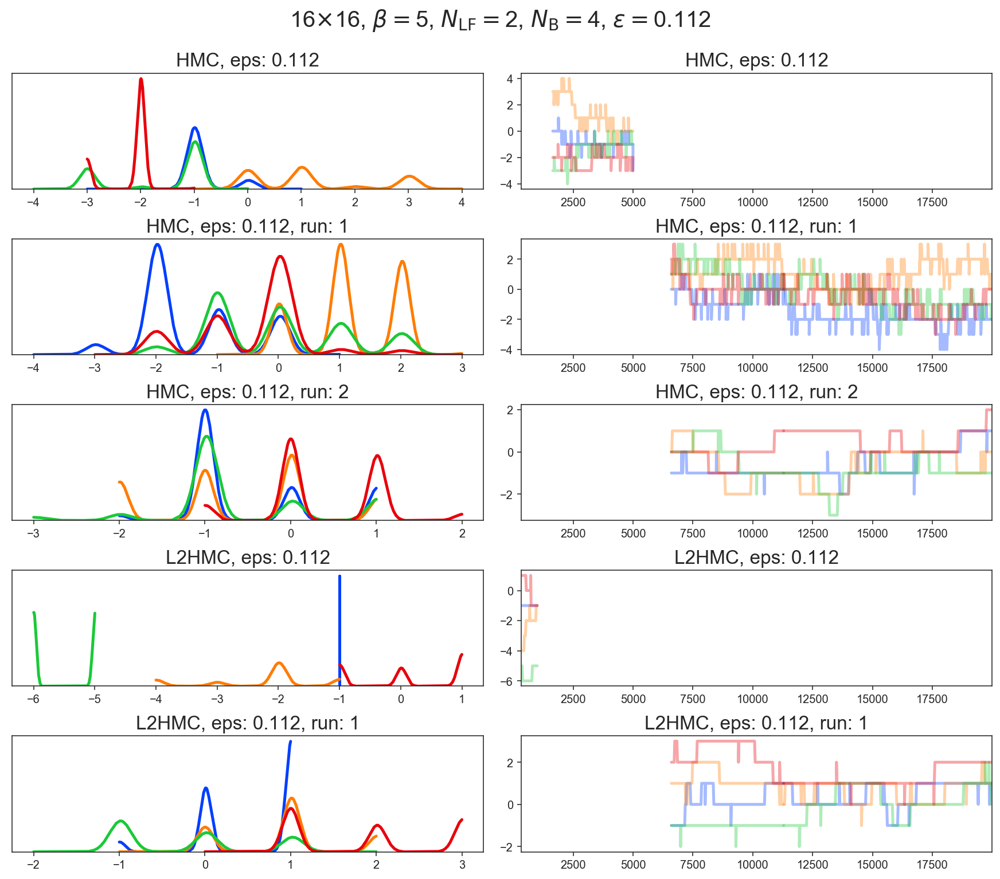

--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
filter_str: beta60
Unable to locate `runs_tf`. Trying with `runs_np`...


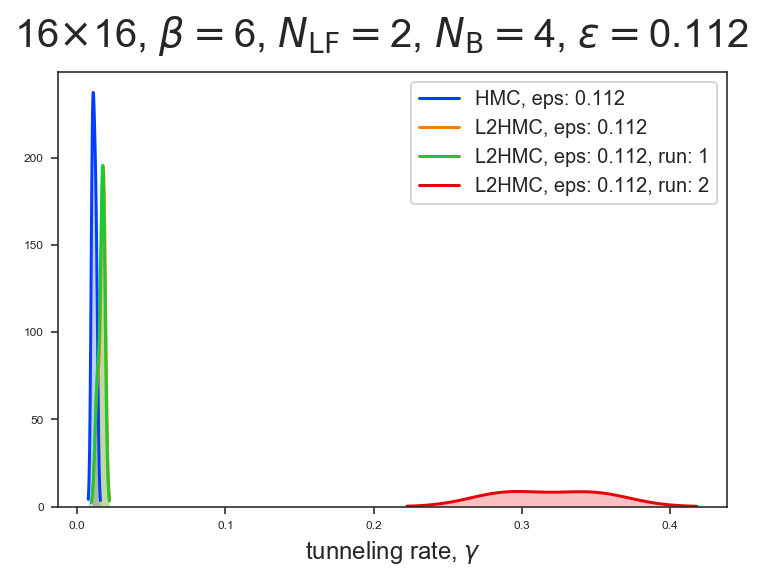

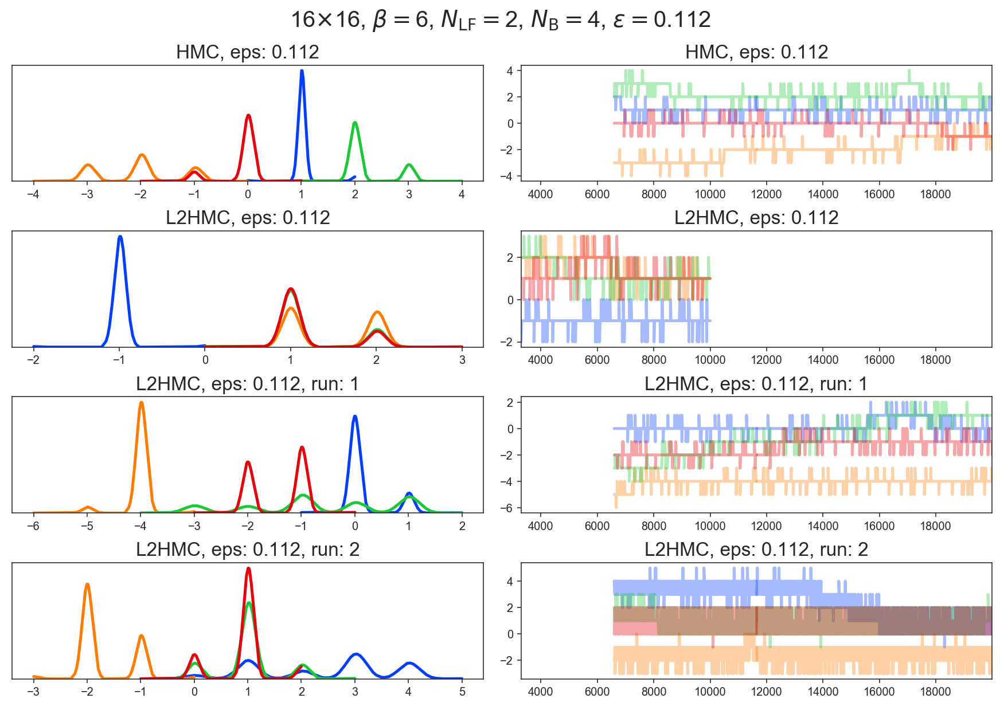

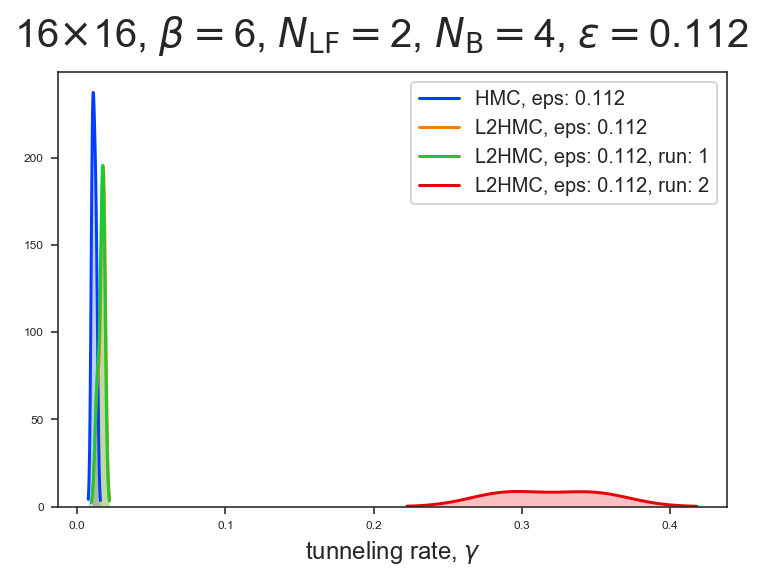

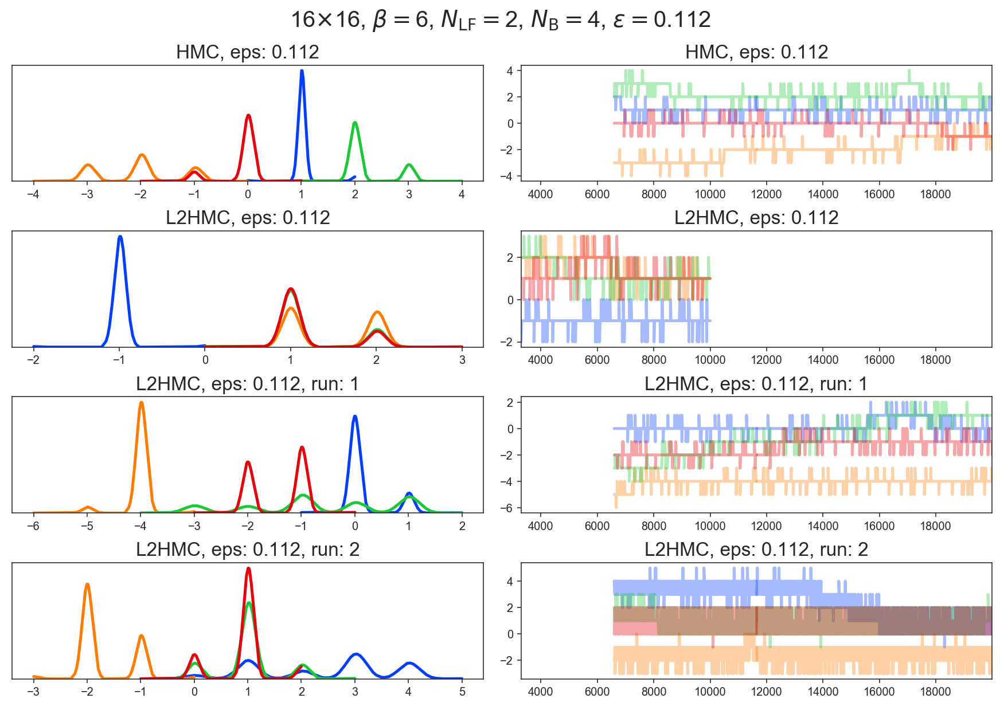

--------------------------------------------------------------------------------
********************************************************************************


********************************************************************************
log_dir: /Users/saforem2/l2hmc-qcd/gauge_logs/cooley_logs/2020_04_29/L8_b1024_lf2_GaugeNetwork_aw00_qw01_dp025_f32_0219
--------------------------------------------------------------------------------
filter_str: beta50
--------------------------------------------------------------------------------
filter_str: beta60
--------------------------------------------------------------------------------
filter_str: beta70
********************************************************************************


********************************************************************************
log_dir: /Users/saforem2/l2hmc-qcd/gauge_logs/cooley_logs/2020_04_29/L12_b1024_lf2_GaugeNetwork_aw00_qw01_dp025_f32_0441_1
************************************************

In [8]:
#USE_TF_RUNS = True
base_dirs = [os.path.abspath('../../gauge_logs/gce_logs/'),
             os.path.abspath('../../gauge_logs/cooley_logs/')]

log_dirs = []
for base_dir in base_dirs:
    date_dirs = [os.path.join(base_dir, i) for i in os.listdir(base_dir)]
    date_dirs = [i for i in date_dirs if os.path.isdir(i)]
    for date_dir in date_dirs:
        contents = os.listdir(date_dir)
        for d in contents:
            dpath = os.path.join(date_dir, d)
            if os.path.isdir(dpath):
                log_dirs.append(dpath)
            
for log_dir in log_dirs:
    print(80 * '*')
    print(f'log_dir: {log_dir}')
    filter_strs = get_unique_betas(log_dir)
    for filter_str in filter_strs:
        print(80 * '-')
        print(f'filter_str: {filter_str}')
        try:
            plot_charges(log_dir, filter_str, use_tf_runs=True) #, include_dq=True)
            plot_charges(log_dir, filter_str, use_tf_runs=False) #, include_dq=True)
        except:
            continue
        
        #plot_tunneling_rates(log_dir, filter_str, use_tf_runs=True)
        #plot_tunneling_rates(log_dir, filter_str, use_tf_runs=False)
        #try:
        #    hmc_l, l2hmc_l, ts = plot_pair_losses(log_dir, filter_str)
        #    plt.show()
        #except:
        #    continue
        print(80 * '-')
    print(80 * '*')
    print('\n')

In [97]:
plot_charges(log_dir, filter_str='beta50', use_tf_runs=True)

FileNotFoundError: [Errno 2] No such file or directory: '/nfs/gce/projects/dlhmc/l2hmc-qcd/gauge_logs/2020_05_18/L16_b1024_lf4_GaugeNetwork_aw00_qw01_pw01_f32_2053/runs_tf'

In [96]:
log_dirs

['/nfs/gce/projects/dlhmc/l2hmc-qcd/gauge_logs/2020_05_13/L16_b1024_lf4_GaugeNetwork_aw00_qw01_pw01_dp05_f32_1252',
 '/nfs/gce/projects/dlhmc/l2hmc-qcd/gauge_logs/2020_05_19/L16_b1024_lf5_GaugeNetwork_aw00_qw01_eps_fixed_f32_2313',
 '/nfs/gce/projects/dlhmc/l2hmc-qcd/gauge_logs/2020_05_14/L16_b1024_lf2_GaugeNetwork_aw00_qw01_pw01_dp05_f32_0203',
 '/nfs/gce/projects/dlhmc/l2hmc-qcd/gauge_logs/2020_05_18/L16_b1024_lf4_GaugeNetwork_aw00_qw01_pw01_f32_2053']

In [79]:
import shutil

In [72]:
def project_angle(x):
    return x - 2 * np.pi * np.floor((x + np.pi) / (2 * np.pi))

def project_angle_fft(x, n=10):
    """use the fourier series representation `x` to approx `project_angle`.
    note: because `project_angle` suffers a discontinuity, we approximate `x`
    with its fourier series representation in order to have a differentiable
    function when computing the loss.
    args:
        x (array-like): array to be projected.
        n (int): number of terms to keep in fourier series.
    """
    y = np.zeros(x.shape, dtype=x.dtype)
    for n in range(1, n):
        y += (-2 / n) * ((-1) ** n) * np.sin(n * x)
    return y

def calc_charges(plaqs):
    pp = project_angle(plaqs)
    return np.sum(pp, axis=(2, 3)) / (2 * np.pi)

def calc_charges_fft(plaqs, n=0):
    if n == 0:
        #plaqs_proj = np.sin(plaqs)
        plaqs_proj = project_angle(plaqs)
    elif n > 0:
        plaqs_proj = project_angle_fft(plaqs, n)
        
    charges = np.sum(plaqs_proj, axis=(2, 3)) / (2 * np.pi)
    
    return charges

In [73]:
log_dirs = [
    os.path.abspath('../../gauge_logs/2020_05_13/'
                    'L16_b1024_lf4_GaugeNetwork_aw00_qw01_pw01_dp05_f32_1252/'),
    os.path.abspath('../../gauge_logs/2020_05_14/'
                    'L16_b1024_lf2_GaugeNetwork_aw00_qw01_pw01_dp05_f32_0203/'),
    os.path.abspath('../../gauge_logs/2020_05_18/'
                    'L16_b1024_lf4_GaugeNetwork_aw00_qw01_pw01_f32_2053/'),
    os.path.abspath('../../gauge_logs/2020_05_19/'
                    'L16_b1024_lf5_GaugeNetwork_aw00_qw01_eps_fixed_f32_2313/') 
]
for log_dir in log_dirs:
    print(80 * '-')
    print(f'log_dir: {log_dir}')
    print(80 * '-')
    runs_dir = os.path.join(log_dir, 'runs_np')
    if os.path.isdir(runs_dir):
        run_dirs = [
            os.path.join(log_dir, 'runs_np', i)
            for i in os.listdir(os.path.join(log_dir, 'runs_np'))
        ]
        run_dirs = [rd for rd in run_dirs if os.path.isdir(rd)]
        for run_dir in run_dirs:
            try:
                plaqs = get_plaqs(run_dir)
            except FileNotFoundError:
                continue

            q = calc_charges(plaqs)
            f = os.path.join(run_dir, 'charges_new.z')
            io.savez(q, f, name=f'charges')
            print(80 * '-')
            #n_fft = [0, 5, 10, 30]
            #for n in n_fft:
            #    q = calc_charges_fft(plaqs, n)
            #    f = os.path.join(run_dir, f'charges_fft{n}.z')
            #    io.savez(q, f, name=f'charges_fft{n}')

--------------------------------------------------------------------------------
log_dir: /nfs/gce/projects/dlhmc/l2hmc-qcd/gauge_logs/2020_05_13/L16_b1024_lf4_GaugeNetwork_aw00_qw01_pw01_dp05_f32_1252
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
log_dir: /nfs/gce/projects/dlhmc/l2hmc-qcd/gauge_logs/2020_05_14/L16_b1024_lf2_GaugeNetwork_aw00_qw01_pw01_dp05_f32_0203
--------------------------------------------------------------------------------
Saving charges to /nfs/gce/projects/dlhmc/l2hmc-qcd/gauge_logs/2020_05_14/L16_b1024_lf2_GaugeNetwork_aw00_qw01_pw01_dp05_f32_0203/runs_np/lf2_bs4_steps50000_beta50_eps017_nw111111_initrand__2020_05_15_0422/charges_new.z.
--------------------------------------------------------------------------------
Saving charges to /nfs/gce/projects/dlhmc/l2hmc-qcd/gauge_logs/2020_05_14/L16_b1024_lf2_GaugeNetwork_aw00_qw01_pw01_dp05_f32_0203/ru

Saving charges to /nfs/gce/projects/dlhmc/l2hmc-qcd/gauge_logs/2020_05_18/L16_b1024_lf4_GaugeNetwork_aw00_qw01_pw01_f32_2053/runs_np/lf4_bs16_steps20000_beta575_eps01_nw000000_initrand__2020_05_19_1508/charges_new.z.
--------------------------------------------------------------------------------
Saving charges to /nfs/gce/projects/dlhmc/l2hmc-qcd/gauge_logs/2020_05_18/L16_b1024_lf4_GaugeNetwork_aw00_qw01_pw01_f32_2053/runs_np/lf4_bs16_steps20000_beta575_eps0104_nw111111_initrand__2020_05_19_1410/charges_new.z.
--------------------------------------------------------------------------------
Saving charges to /nfs/gce/projects/dlhmc/l2hmc-qcd/gauge_logs/2020_05_18/L16_b1024_lf4_GaugeNetwork_aw00_qw01_pw01_f32_2053/runs_np/lf4_bs16_steps20000_beta625_eps0104_nw111111_initrand__2020_05_19_1545/charges_new.z.
--------------------------------------------------------------------------------
Saving charges to /nfs/gce/projects/dlhmc/l2hmc-qcd/gauge_logs/2020_05_18/L16_b1024_lf4_GaugeNetwork_a

In [193]:
import shutil

def mv_charges(run_dir):
    orig_file = os.path.join(run_dir, 'charges.z')
    new_file = os.path.join(run_dir, 'charges_orig.z')
    shutil.move(orig_file, new_file)



Saving charges to /Users/saforem2/l2hmc-qcd/gauge_logs/cooley_logs/2020_05_13/L16_b2048_lf2_GaugeNetwork_aw00_qw01_pw01_dp025_f32_1747_1/runs_np/lf2_bs8_steps20000_beta80_eps0126_nw111111_initrand__2020_05_14_1954/charges_fft30.z.
Saving charges to /Users/saforem2/l2hmc-qcd/gauge_logs/cooley_logs/2020_05_13/L16_b2048_lf2_GaugeNetwork_aw00_qw01_pw01_dp025_f32_1747_1/runs_np/lf2_bs8_steps20000_beta60_eps0126_nw111111_initrand__2020_05_14_0215/charges_fft30.z.
Saving charges to /Users/saforem2/l2hmc-qcd/gauge_logs/cooley_logs/2020_05_13/L16_b2048_lf2_GaugeNetwork_aw00_qw01_pw01_dp025_f32_1747_1/runs_np/lf2_bs8_steps20000_beta65_eps0126_nw111111_initrand__2020_05_14_0245/charges_fft30.z.
Saving charges to /Users/saforem2/l2hmc-qcd/gauge_logs/cooley_logs/2020_05_13/L16_b2048_lf2_GaugeNetwork_aw00_qw01_pw01_dp025_f32_1747_1/runs_np/lf2_bs8_steps20000_beta75_eps0126_nw000000_initrand__2020_05_14_2054/charges_fft30.z.
Saving charges to /Users/saforem2/l2hmc-qcd/gauge_logs/cooley_logs/2020_05_1

In [ ]:
shutil.move()

In [ ]:
def plot_charges(log_dir, filter_str, fft=0, include_dq=False):
    #hmc_dir, l2hmc_dir, title_str, eps_arr = plot_setup(log_dir, filter_str)
    hdirs, heps, ldirs, leps, title_str = plot_setup(log_dir, filter_str)
    try:
        qhmc = [get_charges(hd) for hd in hdirs]
        ql2hmc = [get_charges(ld) for ld in ldirs]
    except:
        return
    
    #title_str = f'top. charge,' + r"$\mathcal{Q}$, " + title_str
        
    #charges_hmc = [get_charges(hd, fft) for hd in hmc_dir]
    #charges_l2hmc = [get_charges(ld, fft) for ld in l2hmc_dir]
    
    data = {}
    data = update_data(data, ql2hmc, key='L2HMC', eps_arr=leps, include_dq=include_dq)
    data = update_data(data, qhmc, key='HMC', eps_arr=heps, include_dq=include_dq)
    
    dataset = xr.Dataset(data)
    az.plot_trace(data)#, trace_kwargs={'linewidth': 1.})
    fig = plt.gcf()
    plt.tight_layout()
    fig.suptitle(title_str, fontsize=20, y=1.05)
    out_file = os.path.join(log_dir, 'figures_np', f'{filter_str}_charges.png')
    plt.savefig(out_file, dpi=400, bbox_inches='tight')
    plt.show()

In [181]:
q = calc_charges(plaqs)
q10 = calc_charges_fft(plaqs, 10)
q50 = calc_charges_fft(plaqs, 10)

In [188]:
q50 = calc_charges_fft(plaqs, 50)
q100 = calc_charges_fft(plaqs, 100)

/Users/saforem2/opt/anaconda3/envs/tf2/lib/python3.6/site-packages/arviz/plots/backends/matplotlib/distplot.py:38: UserWarning: Argument backend_kwargs has not effect in matplotlib.plot_distSupplied value won't be used
  "Argument backend_kwargs has not effect in matplotlib.plot_dist"
/Users/saforem2/opt/anaconda3/envs/tf2/lib/python3.6/site-packages/arviz/plots/backends/matplotlib/distplot.py:38: UserWarning: Argument backend_kwargs has not effect in matplotlib.plot_distSupplied value won't be used
  "Argument backend_kwargs has not effect in matplotlib.plot_dist"
/Users/saforem2/opt/anaconda3/envs/tf2/lib/python3.6/site-packages/arviz/plots/backends/matplotlib/distplot.py:38: UserWarning: Argument backend_kwargs has not effect in matplotlib.plot_distSupplied value won't be used
  "Argument backend_kwargs has not effect in matplotlib.plot_dist"
/Users/saforem2/opt/anaconda3/envs/tf2/lib/python3.6/site-packages/arviz/plots/backends/matplotlib/distplot.py:38: UserWarning: Argument backe

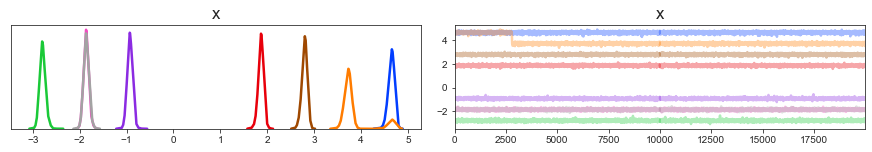

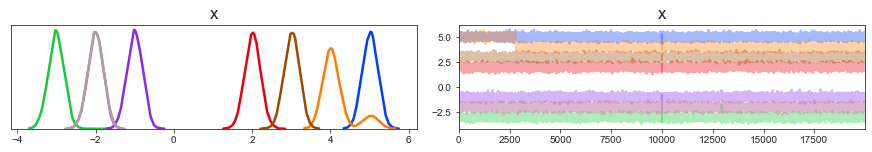

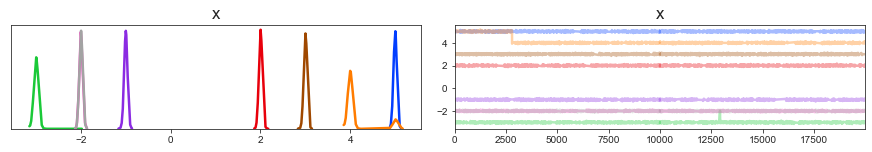

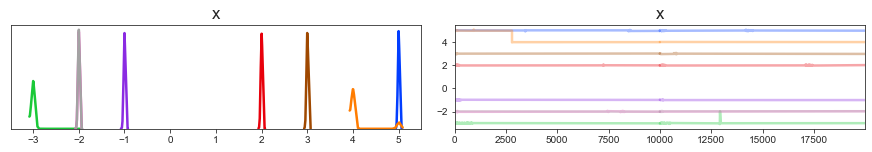

In [189]:
az.plot_trace(q.T)
az.plot_trace(q10.T)
az.plot_trace(q50.T)
az.plot_trace(q100.T)
plt.show()

/Users/saforem2/opt/anaconda3/envs/tf2/lib/python3.6/site-packages/arviz/plots/backends/matplotlib/distplot.py:38: UserWarning: Argument backend_kwargs has not effect in matplotlib.plot_distSupplied value won't be used
  "Argument backend_kwargs has not effect in matplotlib.plot_dist"
/Users/saforem2/opt/anaconda3/envs/tf2/lib/python3.6/site-packages/arviz/plots/backends/matplotlib/distplot.py:38: UserWarning: Argument backend_kwargs has not effect in matplotlib.plot_distSupplied value won't be used
  "Argument backend_kwargs has not effect in matplotlib.plot_dist"
/Users/saforem2/opt/anaconda3/envs/tf2/lib/python3.6/site-packages/arviz/plots/backends/matplotlib/distplot.py:38: UserWarning: Argument backend_kwargs has not effect in matplotlib.plot_distSupplied value won't be used
  "Argument backend_kwargs has not effect in matplotlib.plot_dist"
/Users/saforem2/opt/anaconda3/envs/tf2/lib/python3.6/site-packages/arviz/plots/backends/matplotlib/distplot.py:38: UserWarning: Argument backe

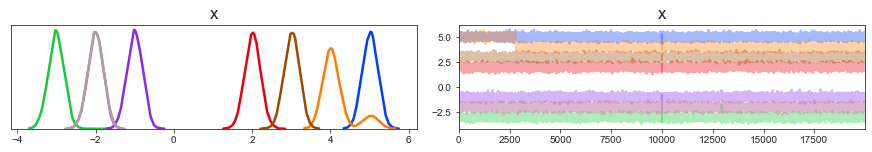

In [186]:
az.plot_trace(q10.T)
plt.show()

/Users/saforem2/opt/anaconda3/envs/tf2/lib/python3.6/site-packages/arviz/plots/backends/matplotlib/distplot.py:38: UserWarning: Argument backend_kwargs has not effect in matplotlib.plot_distSupplied value won't be used
  "Argument backend_kwargs has not effect in matplotlib.plot_dist"
/Users/saforem2/opt/anaconda3/envs/tf2/lib/python3.6/site-packages/arviz/plots/backends/matplotlib/distplot.py:38: UserWarning: Argument backend_kwargs has not effect in matplotlib.plot_distSupplied value won't be used
  "Argument backend_kwargs has not effect in matplotlib.plot_dist"
/Users/saforem2/opt/anaconda3/envs/tf2/lib/python3.6/site-packages/arviz/plots/backends/matplotlib/distplot.py:38: UserWarning: Argument backend_kwargs has not effect in matplotlib.plot_distSupplied value won't be used
  "Argument backend_kwargs has not effect in matplotlib.plot_dist"
/Users/saforem2/opt/anaconda3/envs/tf2/lib/python3.6/site-packages/arviz/plots/backends/matplotlib/distplot.py:38: UserWarning: Argument backe

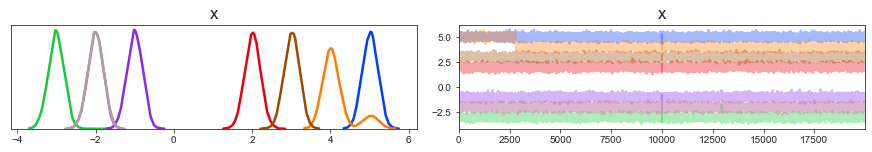

In [187]:
az.plot_trace(q50.T)
plt.show()

In [ ]:
plaqs = get_

In [135]:
ax = axes.get_children()[0]


In [136]:
axes = plt.gca()

In [140]:
axes.texts

[]

In [40]:
%debug

> /nfs/gce/projects/dlhmc/l2hmc-qcd/l2hmc-qcd/utils/file_io.py(158)load_pkl()
    156 def load_pkl(fpath):
    157     """Load from `fpath` using `pickle.load`."""
--> 158     with open(fpath, 'rb') as f:
    159         data = pickle.load(f)
    160 

ipdb> fpath
'/nfs/gce/projects/dlhmc/l2hmc-qcd/gauge_logs/2020_05_18/L16_b1024_lf4_GaugeNetwork_aw00_qw01_pw01_f32_2053/runs_np/lf4_bs16_steps500_beta50_eps0104_nw000000_initrand__2020_05_19_1103/charges.pkl'
ipdb> up
> /nfs/gce/projects/dlhmc/l2hmc-qcd/l2hmc-qcd/utils/file_io.py(130)loadz()
    128     except FileNotFoundError:
    129         fpath_pkl = change_extension(fpath, 'pkl')
--> 130         obj = load_pkl(fpath_pkl)
    131 
    132     return obj

ipdb> up
> <ipython-input-16-093056952bab>(19)get_charges()
     17 
     18     f = os.path.join(run_dir, 'charges.z')
---> 19     return io.loadz(f)
     20 
     21 def get_plaqs(run_dir):

ipdb> l
     14     fnew = os.path.join(run_dir, 'charges_new.z')
     15     if os.path.

In [32]:
%debug

> /nfs/gce/projects/dlhmc/l2hmc-qcd/l2hmc-qcd/utils/file_io.py(158)load_pkl()
    156 def load_pkl(fpath):
    157     """Load from `fpath` using `pickle.load`."""
--> 158     with open(fpath, 'rb') as f:
    159         data = pickle.load(f)
    160 

ipdb> fpath
'/nfs/gce/projects/dlhmc/l2hmc-qcd/gauge_logs/2020_05_19/L16_b1024_lf5_GaugeNetwork_aw00_qw01_eps_fixed_f32_2313/runs_np/lf5_bs16_steps10000_beta50_eps02_nw000000_initrand__2020_05_20_0949/charges.pkl'
ipdb> up
> /nfs/gce/projects/dlhmc/l2hmc-qcd/l2hmc-qcd/utils/file_io.py(130)loadz()
    128     except FileNotFoundError:
    129         fpath_pkl = change_extension(fpath, 'pkl')
--> 130         obj = load_pkl(fpath_pkl)
    131 
    132     return obj

ipdb> l
    125     """Load from `fpath` using `joblib.load`."""
    126     try:
    127         obj = joblib.load(fpath)
    128     except FileNotFoundError:
    129         fpath_pkl = change_extension(fpath, 'pkl')
--> 130         obj = load_pkl(fpath_pkl)
    131 
    13

In [ ]:
axes.

In [144]:
run_dir = os.path.join(log_dir, 'runs_np', 'lf2_bs3_steps20000_beta50_eps0165_nw000000_rand__2020_05_05_0428')
charges_file = os.path.join(run_dir, 'observables', 'charges.z')
charges = io.loadz(charges_file)

In [145]:
tunn_stats = calc_tunneling_stats(charges)

In [149]:
plt.clf()

/Users/saforem2/opt/anaconda3/envs/tf2/lib/python3.6/site-packages/arviz/plots/backends/matplotlib/distplot.py:38: UserWarning: Argument backend_kwargs has not effect in matplotlib.plot_distSupplied value won't be used
  "Argument backend_kwargs has not effect in matplotlib.plot_dist"
/Users/saforem2/opt/anaconda3/envs/tf2/lib/python3.6/site-packages/arviz/plots/backends/matplotlib/distplot.py:38: UserWarning: Argument backend_kwargs has not effect in matplotlib.plot_distSupplied value won't be used
  "Argument backend_kwargs has not effect in matplotlib.plot_dist"
/Users/saforem2/opt/anaconda3/envs/tf2/lib/python3.6/site-packages/arviz/plots/backends/matplotlib/distplot.py:38: UserWarning: Argument backend_kwargs has not effect in matplotlib.plot_distSupplied value won't be used
  "Argument backend_kwargs has not effect in matplotlib.plot_dist"


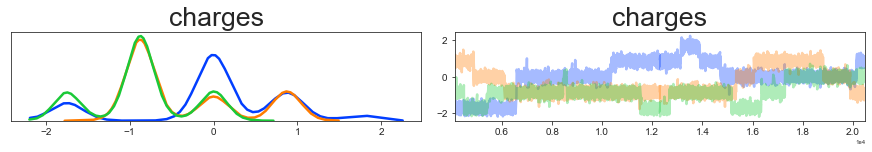

In [153]:
import xarray as xr

q = np.array(charges.T)
arr, steps = therm_arr(np.array(q))
data = {
    'charges': xr.DataArray(arr, dims=['chain', 'draw'],
                            coords=[np.arange(arr.shape[0]), steps])
}
dataset = xr.Dataset(data)
az.plot_trace(dataset)
plt.show()

In [113]:
#log_dir = os.path.abspath('../../gauge_logs/2020_04_28/L12_b128_lf2_GaugeNetwork_aw00_qw01_dp025_f32_0146/')
#log_dir = os.path.abspath('../../gauge_logs/2020_04_29/L16_b256_lf2_GaugeNetwork_aw00_qw01_dp05_f32_1427/')
runs_dir = os.path.join(log_dir, 'runs_np')
run_dirs = io.get_subdirs(runs_dir)
filter_str = 'beta50'
run_dirs = [i for i in run_dirs if filter_str in i and 'mix_samplers' not in i]
run_dirs

['/Users/saforem2/l2hmc-qcd/gauge_logs/2020_04_29/L16_b256_lf2_GaugeNetwork_aw00_qw01_dp05_f32_1427/runs_np/lf2_bs1_steps50000_beta50_eps011_nw111111_rand__2020_04_30_0128',
 '/Users/saforem2/l2hmc-qcd/gauge_logs/2020_04_29/L16_b256_lf2_GaugeNetwork_aw00_qw01_dp05_f32_1427/runs_np/lf2_bs1_steps50000_beta50_eps011_nw111111_rand__2020_04_30_1228',
 '/Users/saforem2/l2hmc-qcd/gauge_logs/2020_04_29/L16_b256_lf2_GaugeNetwork_aw00_qw01_dp05_f32_1427/runs_np/lf2_bs1_steps50000_beta50_eps011_nw000000_rand__2020_04_29_2351',
 '/Users/saforem2/l2hmc-qcd/gauge_logs/2020_04_29/L16_b256_lf2_GaugeNetwork_aw00_qw01_dp05_f32_1427/runs_np/lf2_bs16_steps50000_beta50_eps011_nw111111_rand__2020_04_30_1221',
 '/Users/saforem2/l2hmc-qcd/gauge_logs/2020_04_29/L16_b256_lf2_GaugeNetwork_aw00_qw01_dp05_f32_1427/runs_np/lf2_bs1_steps50000_beta50_eps011_nw111111_rand__2020_04_30_0614',
 '/Users/saforem2/l2hmc-qcd/gauge_logs/2020_04_29/L16_b256_lf2_GaugeNetwork_aw00_qw01_dp05_f32_1427/runs_np/lf2_bs16_steps50000_b

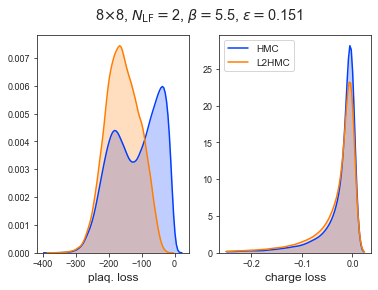

In [59]:
plot_densities(losses_hmc, losses_l2hmc, title_str)
plt.show()

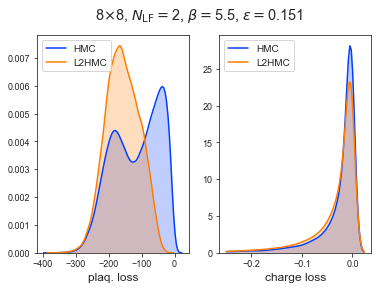

In [ ]:
#filter_strs = ['beta50', 'beta55', 'beta60', 'beta70']
for filter_str in filter_strs:
    plot_pair_losses(log_dir, filter_str)